In [1]:
import os
print(os.path.abspath('.'))

/data/jinwf/wangxf/jupyter_notebook/Python/Velocity/MDSC


In [2]:
import sys
print(sys.version)
print(sys.executable)

3.8.2 (default, Apr 19 2020, 16:19:43) 
[GCC 4.8.5 20150623 (Red Hat 4.8.5-39)]
/home/wangxf/data/tools/python3/bin/python3.8


In [3]:
import sys
import numpy as np
from scipy.stats import norm
from scipy.spatial.distance import pdist, squareform
import matplotlib
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import loompy
import velocyto as vcy
import pandas as pd
import json

# from IPython.core.display import display, HTML
# import logging
# logging.basicConfig(stream=sys.stdout, format='%(asctime)s - %(levelname)s - %(message)s', level=logging.DEBUG)
# display(HTML("<style>.container { width:90% !important; }</style>"))
%matplotlib inline

import scanpy as sc
import scvelo as scv
# scv.logging.print_version() #only run once

scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization

import cellrank as cr
import numpy as np
cr.settings.verbosity = 2

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 6103. The TBB threading layer is disabled.
  warnings.warn(problem)


# subMac analysis

## scvelo analysis

### subset subMac data

In [4]:
# set colors
colfile = open("./datasource/CRCcolList.json","r")
CRCcolList = json.load(colfile)
print(CRCcolList)

{'mycol_MacDC': ['#fdc086', '#f2991a', '#cc051a', '#cf6eb8', '#e58f70', '#d94c1a', '#e6cc4c', '#b2d199', '#e76da2', '#72daf2'], 'mycol_Neu': ['#3387b5', '#beaed4', '#7fc97f', '#3abca5', '#dbb972', '#b49674', '#e26a46', '#be71af'], 'mycol_Mast': ['#d7ce96', '#e57371', '#c5aac3'], 'mycol_subMye': ['#fdc086', '#f2991a', '#cc051a', '#cf6eb8', '#e58f70', '#d94c1a', '#e6cc4c', '#b2d199', '#e76da2', '#72daf2', '#3387b5', '#beaed4', '#7fc97f', '#3abca5', '#dbb972', '#b49674', '#e26a46', '#be71af', '#d7ce96', '#e57371', '#c5aac3'], 'TcelltypeCols': ['#91d5e5', '#d71e26', '#d9a86a', '#f6b62a', '#be71af', '#f5797c', '#3abca5', '#8c9fd2', '#87c963'], 'tissueCols': ['#fd8b7b', '#93b9d8', '#febe65']}


In [6]:
# adata_Mac = scv.read("./write/MDSC_subMac_scvelo.h5ad")
adata_subMye_all = scv.read_loom("./write/MDSC_subMye_scvelo.loom")

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [7]:
adata_subMye_all.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,newcluster1,obs_names,orig.ident,percent.mt,percent.rp
0,4,Neutrophil,Neutrophil,-28.611614,-8.926436,mM18_gMDSC_Prdx1,mM18,KO,1016,324,mM18,H389WT_out:TCCGATCGTCGTACTAx,H389KO,1.673228,4.625984
1,2,Macrophage,Macrophage,14.686928,6.502661,mM05_TAM_Ccl8,mM05,KO,28583,4725,mM05,H389WT_out:TGCCGAGCACGCAGTCx,H389KO,6.265962,5.587237
2,2,Neutrophil,Neutrophil,22.081251,21.456640,mM14_gMDSC_Clec5a,mM14,WT,986,481,mM14,H124KO_out:CATTTCATCTAAACGCx,H124WT,3.144016,2.636917
3,1,Macrophage,Macrophage,-9.860976,-14.656569,mM01_mMDSC_Ccr2,mM01,KO,14345,3240,mM01,H389WT_out:CTATAGGCAGGACTTTx,H389KO,3.736494,16.653886
4,3,Neutrophil,Neutrophil,-7.907442,49.644989,mM14_gMDSC_Clec5a,mM14,KO,4366,1042,mM14,H389WT_out:ATGGGTTCATGAAAGTx,H389KO,1.488777,2.175905
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7818,5,Macrophage,Macrophage,-23.798615,-25.518599,mM02_mMDSC_Timp1,mM02,KO,7944,2345,mM02,H382jia390KO_out:CTGCGAGGTCAATGGGx,H382jia390KO,3.197382,14.375629
7819,3,Neutrophil,Neutrophil,8.278304,21.180367,mM18_gMDSC_Prdx1,mM18,KO,7060,1172,mM18,H389WT_out:TTCGGTCCATGGATCTx,H389KO,50.920680,2.195467
7820,2,Neutrophil,Neutrophil,15.028574,7.519513,mM12_gMDSC_Mmp8,mM12,KO,6566,1337,mM12,H389WT_out:CCTACGTAGGAGATAGx,H389KO,1.248858,2.558635
7821,9,Neutrophil,Neutrophil,1.329970,51.792625,mM15_gMDSC_Id1,mM15,WT,4130,965,mM15,H119WT_out:GGAGAACCAAGCCCACx,H119WT,0.895884,2.445521


In [8]:
adata_subMye_all.obs["Tcelltype"].unique()

array(['Neutrophil', 'Macrophage', 'Mast cell', 'DC'], dtype=object)

In [9]:
subName_Mac = adata_subMye_all.obs.loc[adata_subMye_all.obs["Tcelltype"]=="Macrophage"]._stat_axis.values.tolist()
adata_Mac = adata_subMye_all[subName_Mac,]
adata_Mac.uns["celltype_colors"]=CRCcolList["mycol_MacDC"]
adata_Mac

Trying to set attribute `.uns` of view, copying.


AnnData object with n_obs × n_vars = 2293 × 31053
    obs: 'Clusters', 'Lcelltype', 'Tcelltype', '_X', '_Y', 'allLabel', 'celltype', 'group', 'nCount_RNA', 'nFeature_RNA', 'newcluster1', 'obs_names', 'orig.ident', 'percent.mt', 'percent.rp'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'var_names'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [10]:
adata_Mac.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,newcluster1,obs_names,orig.ident,percent.mt,percent.rp
1,2,Macrophage,Macrophage,14.686928,6.502661,mM05_TAM_Ccl8,mM05,KO,28583,4725,mM05,H389WT_out:TGCCGAGCACGCAGTCx,H389KO,6.265962,5.587237
3,1,Macrophage,Macrophage,-9.860976,-14.656569,mM01_mMDSC_Ccr2,mM01,KO,14345,3240,mM01,H389WT_out:CTATAGGCAGGACTTTx,H389KO,3.736494,16.653886
5,10,Macrophage,Macrophage,28.387337,-18.500486,mM01_mMDSC_Ccr2,mM01,WT,12833,2837,mM01,H124KO_out:GACCGTGTCCAACACAx,H124WT,4.394919,19.925193
14,5,Macrophage,Macrophage,30.297018,-10.075708,mM01_mMDSC_Ccr2,mM01,KO,16241,3114,mM01,H389WT_out:TGGATCAAGATTGTGAx,H389KO,3.688197,24.444308
15,7,Macrophage,Macrophage,14.302183,7.288043,mM02_mMDSC_Timp1,mM02,WT,12180,2629,mM02,H124KO_out:TCTCAGCTCGCTAGCGx,H124WT,4.039409,16.945813
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7801,5,Macrophage,Macrophage,-13.967816,18.873419,mM04_TAM_Mfge8,mM04,WT,25058,4735,mM04,H124KO_out:GGTCACGAGGGTTAGCx,H124WT,5.503233,8.959215
7802,8,Macrophage,Macrophage,43.493626,5.100000,mM01_mMDSC_Ccr2,mM01,WT,8582,2313,mM01,H124KO_out:TTTCAGTGTTGTATGCx,H124WT,3.390818,21.999534
7809,0,Macrophage,Macrophage,-12.803620,17.121191,mM05_TAM_Ccl8,mM05,KO,16569,3477,mM05,H389WT_out:TTGTTGTGTAGAATACx,H389KO,5.286982,14.720261
7818,5,Macrophage,Macrophage,-23.798615,-25.518599,mM02_mMDSC_Timp1,mM02,KO,7944,2345,mM02,H382jia390KO_out:CTGCGAGGTCAATGGGx,H382jia390KO,3.197382,14.375629


In [11]:
# tissueCols = ["#f8766d","#00bfc4"]
adata_Mac.uns["group_colors"]=["#f8766d","#00bfc4"]

In [12]:
adata = adata_Mac

In [22]:
# subName_Mac = adata_subMye_all.obs.loc[adata_subMye_all.obs["Tcelltype"]=="Macrophage"]._stat_axis.values.tolist()
# subName_mM06 = adata_subMye_all.obs.loc[adata_subMye_all.obs["newcluster1"]=="mM06"]._stat_axis.values.tolist()
# x = list(set(subName_Mac).difference(set(subName_mM06)))
# print(len(x))

2212


In [31]:
#write scVelo analysis file
adata.write("./write/MDSC_subMac_scvelo_20210508.h5ad")
#read scVelo analysis file
# adata = scv.read("./write/MDSC_subMac_scvelo_20210508.h5ad")

... storing 'Lcelltype' as categorical
... storing 'Tcelltype' as categorical


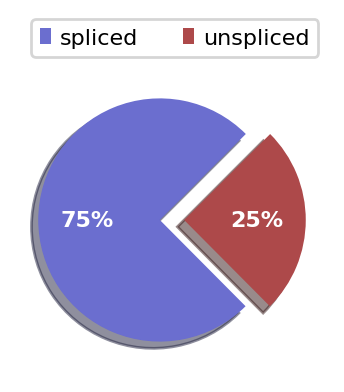

In [13]:
scv.pl.proportions(adata)

### Pre-process the data

In [14]:
# filter genes and cells
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=3000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

# velocity analysis
scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)

Filtered out 22146 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 3000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:03) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


### Run scVelo

In [15]:
scv.tl.recover_dynamics(adata, n_jobs=8)

recovering dynamics (using 8/192 cores)



    finished (0:00:45) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [16]:
scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


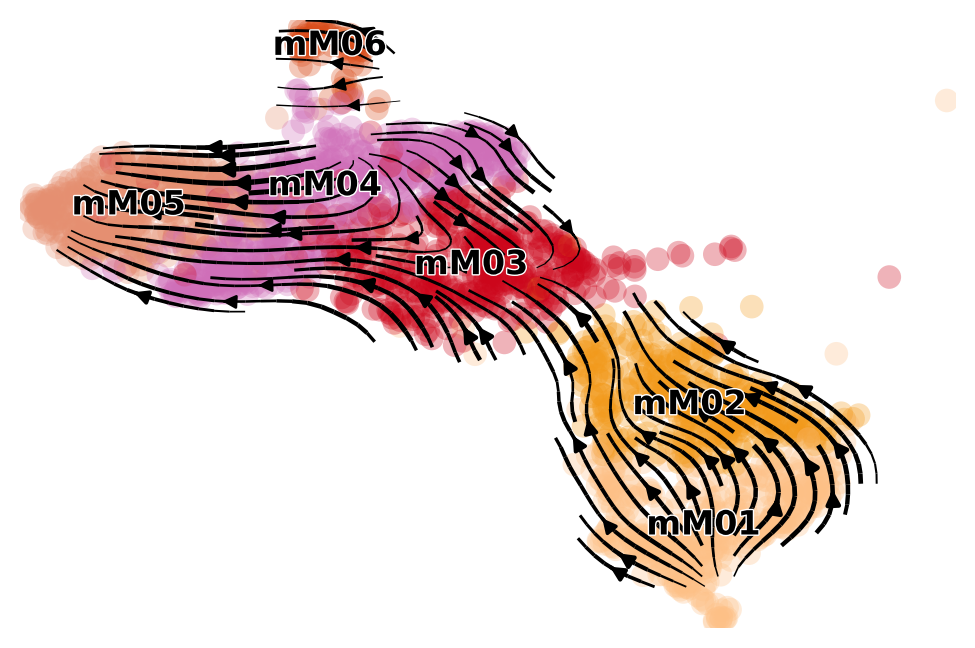

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


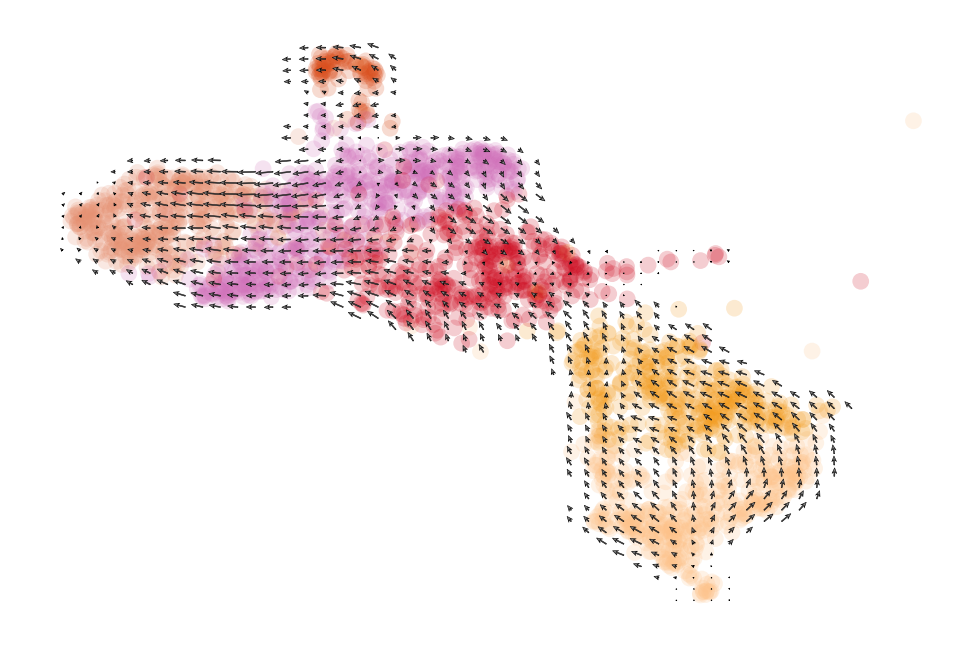

In [17]:
scv.pl.velocity_embedding_stream(adata, basis='umap',color=["celltype"], legend_fontsize=12, title='', smooth=.8, min_mass=4)
scv.pl.velocity_embedding_grid(adata, basis='umap',color=["celltype"], legend_fontsize=12, title='', smooth=.8, min_mass=4)

In [18]:
adata.var.index = adata.var['var_names'].tolist()#修改行名
# adata.var=adata.var.drop(['var_names'], axis=1)#删除dataframe某一列
adata.var

,Accession,Chromosome,End,Start,Strand,var_names,gene_count_corr,means,dispersions,dispersions_norm,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
Vcpip1,ENSMUSG00000045210,1,9748382,9718622,-,Vcpip1,-0.1147,0.408892,0.594542,0.493379,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.507336
Mcm3,ENSMUSG00000041859,1,20820312,20802968,-,Mcm3,0.2911,0.239664,0.477011,0.571002,...,0.461796,0.156336,0.0,0.0,0.493211,0.042518,1.986488,1.261989,2.058853,0.157100
Ogfrl1,ENSMUSG00000026158,1,23397772,23366424,-,Ogfrl1,0.0289,0.446088,0.527179,0.302031,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.033149
Ptp4a1,ENSMUSG00000026064,1,30949770,30940302,-,Ptp4a1,-0.0597,0.282167,0.431658,0.431751,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.013092
Neurl3,ENSMUSG00000047180,1,36274679,36264597,-,Neurl3,-0.0721,0.414537,0.506760,0.244029,...,0.243676,0.327098,0.0,0.0,0.327231,1.155318,0.723117,0.493751,2.417581,0.333516
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Map3k15,ENSMUSG00000031303,X,160123351,159988433,+,Map3k15,-0.0431,0.039849,0.710685,1.288461,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.987124
Ap1s2,ENSMUSG00000031367,X,163933666,163909017,+,Ap1s2,-0.1676,0.417435,0.732635,0.885641,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.058278
Piga,ENSMUSG00000031381,X,164433916,164419787,+,Piga,-0.0209,0.055174,0.361983,0.217823,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.196210
Arhgap6,ENSMUSG00000031355,X,169304435,168795099,+,Arhgap6,-0.0580,0.042763,0.867287,1.769287,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.712923


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_subMac_20210508.pdf


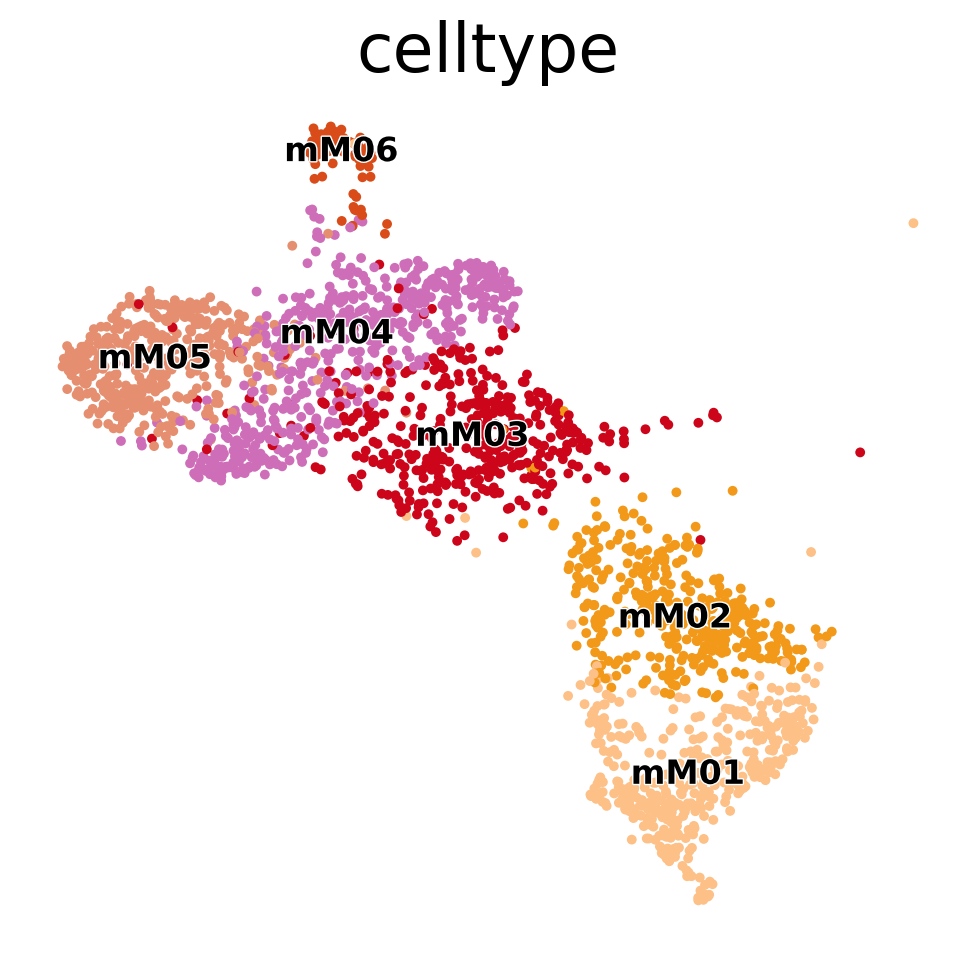

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_stream_subMac_20210508.pdf


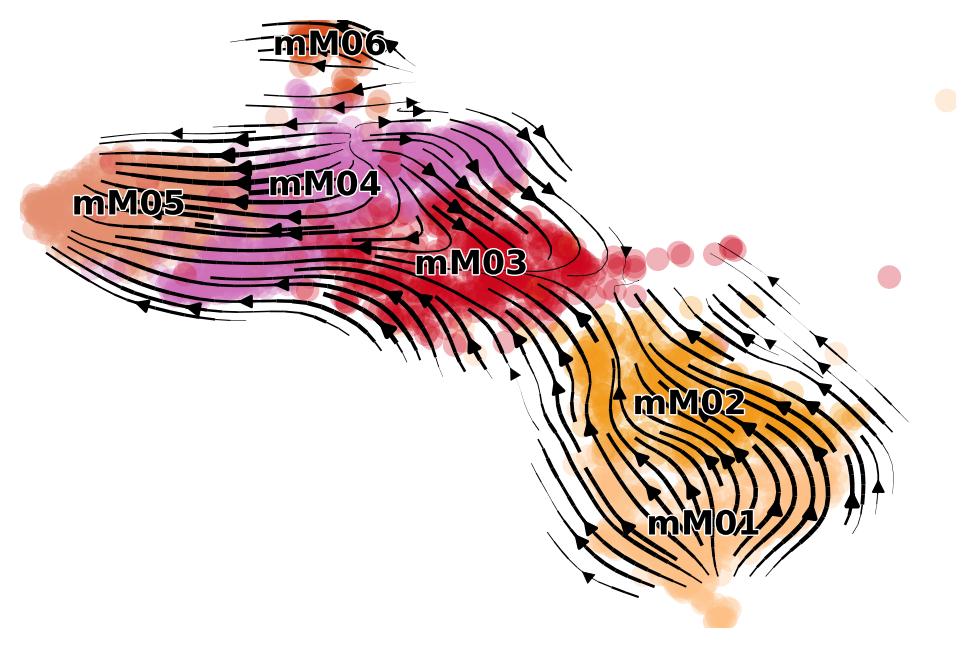

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_grid_subMac_20210508.pdf


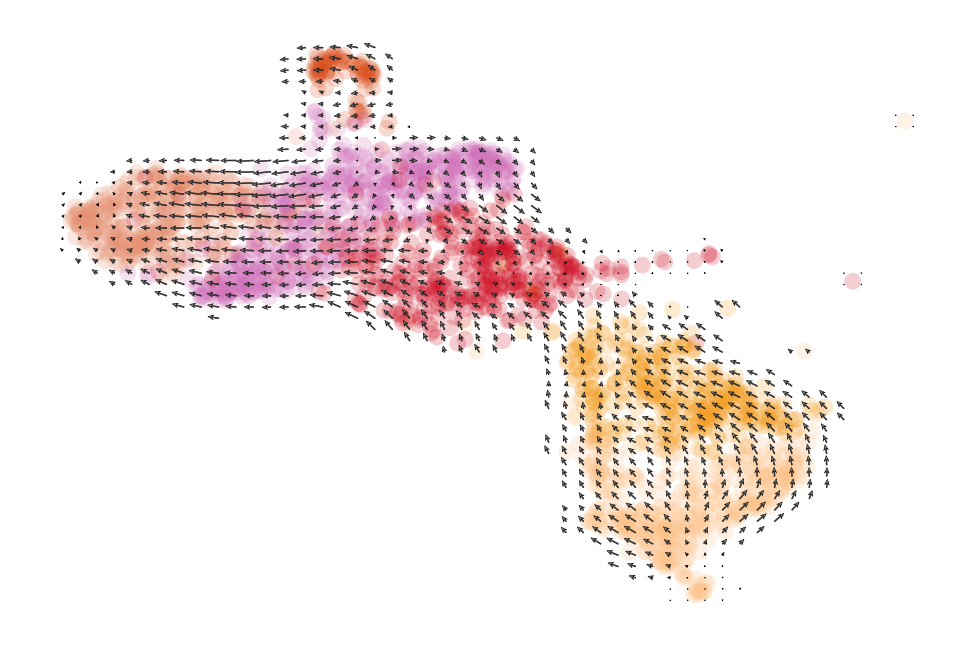

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


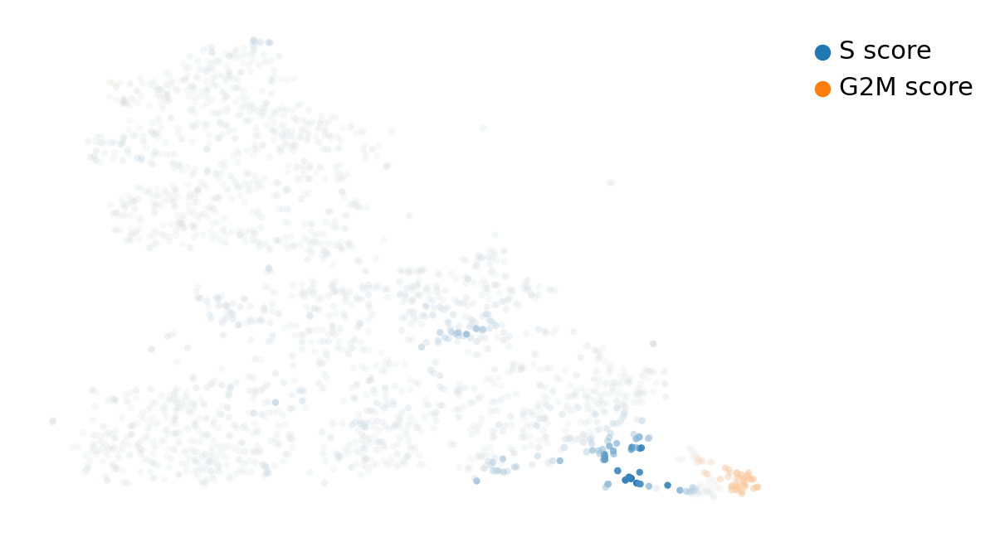

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
saving figure to file ./figures/scvelo_RootEndplot_subMac_20210508.pdf


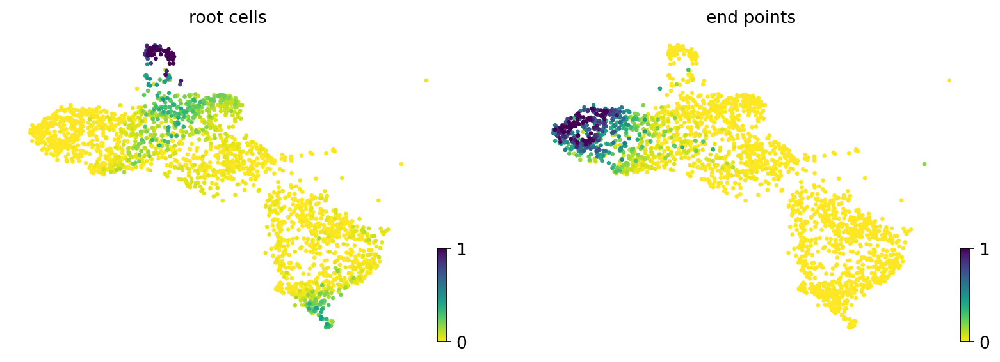

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_pseudotime_subMac_20210508.pdf


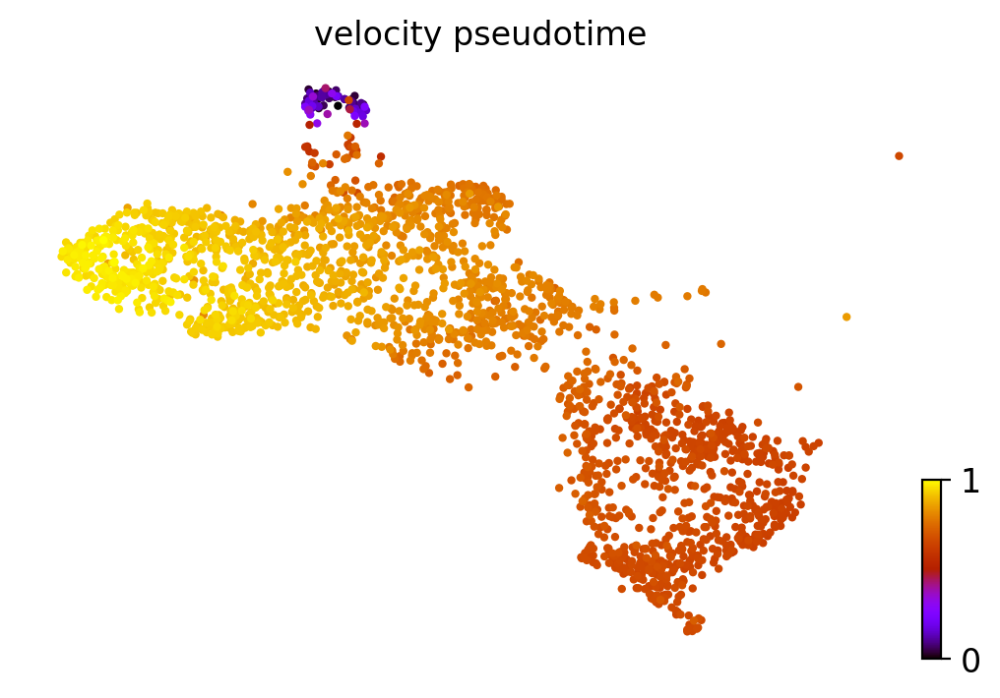

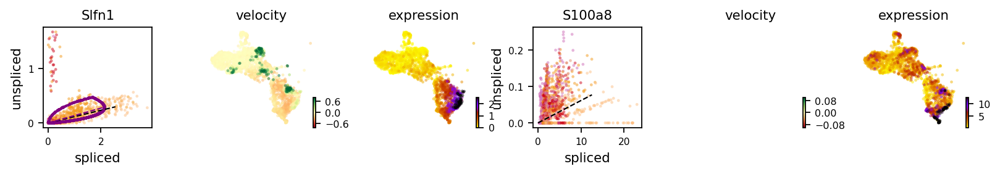

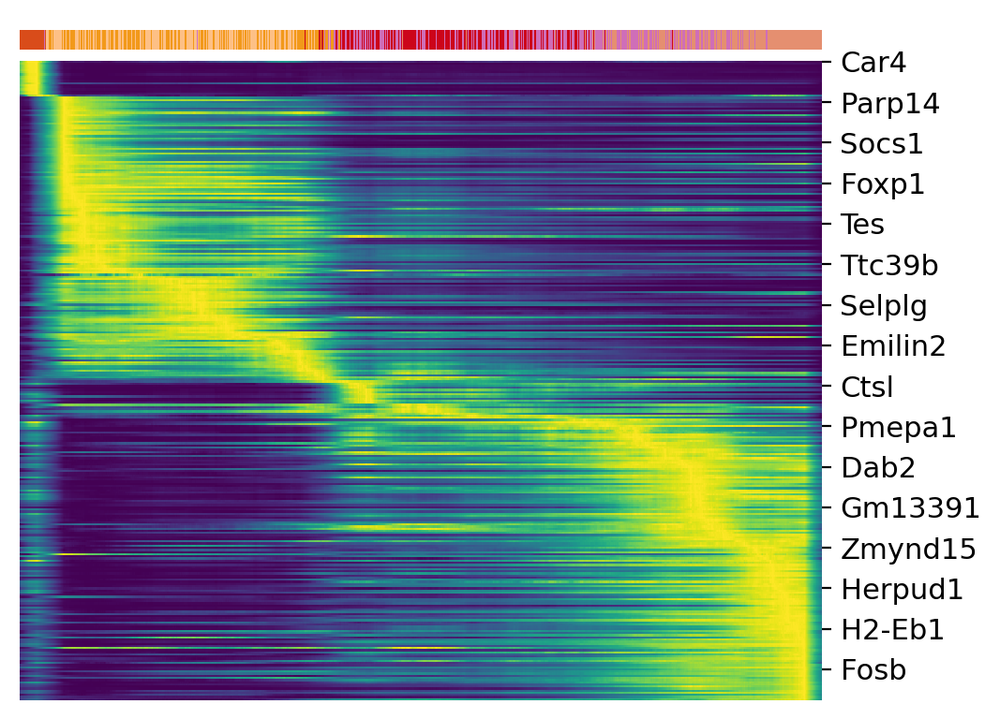

In [19]:
# tsne and umap plot 
# scv.pl.scatter(adata, color='celltype', fontsize=24, size=50,basis="tsne",
#                color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(6,5.6),save="tsneplot_subMac_20210508.pdf")
scv.pl.scatter(adata, color='celltype', fontsize=24, size=50,basis="umap",
               color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(6,5.6),save="umapplot_subMac_20210508.pdf")
# velocity embedding stream and grid plot ##30PCs+3000genes
scv.pl.velocity_embedding_stream(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',save="umapplot_stream_subMac_20210508.pdf")
scv.pl.velocity_embedding_grid(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',save="umapplot_grid_subMac_20210508.pdf")
# scv.pl.velocity_embedding_stream(adata, basis='tsne', title='', smooth=.8, min_mass=2,color='celltype')
# scv.pl.velocity_embedding_grid(adata, basis='tsne', title='', smooth=.8, min_mass=2,color='celltype')
# cellcycle
scv.tl.score_genes_cell_cycle(adata)
scv.pl.scatter(adata,color_gradients=['S_score','G2M_score'],basis="tsne",smooth=True,perc=[5,95])
# find root and terminal cell
scv.tl.terminal_states(adata)
scv.pl.scatter(adata,color=['root_cells','end_points'],basis='umap',save="RootEndplot_subMac_20210508.pdf")
# pseudotime anaysis and plot
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata,color='velocity_pseudotime',cmap='gnuplot',basis='umap',save="pseudotime_subMac_20210508.pdf")
# mapping special genes on velocity plot
var_names = ['Slfn1','S100a8']
scv.pl.velocity(adata,var_names=var_names,colorbar=True,ncols=2,basis='umap',color="celltype")
# heatmap along velocity pseudotime
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
# options(repr.plot.width=6, repr.plot.height=5)
scv.pl.heatmap(adata, var_names=top_genes,sortby='velocity_pseudotime', n_convolve=100, col_color='celltype',figsize=(5.5,4))

computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


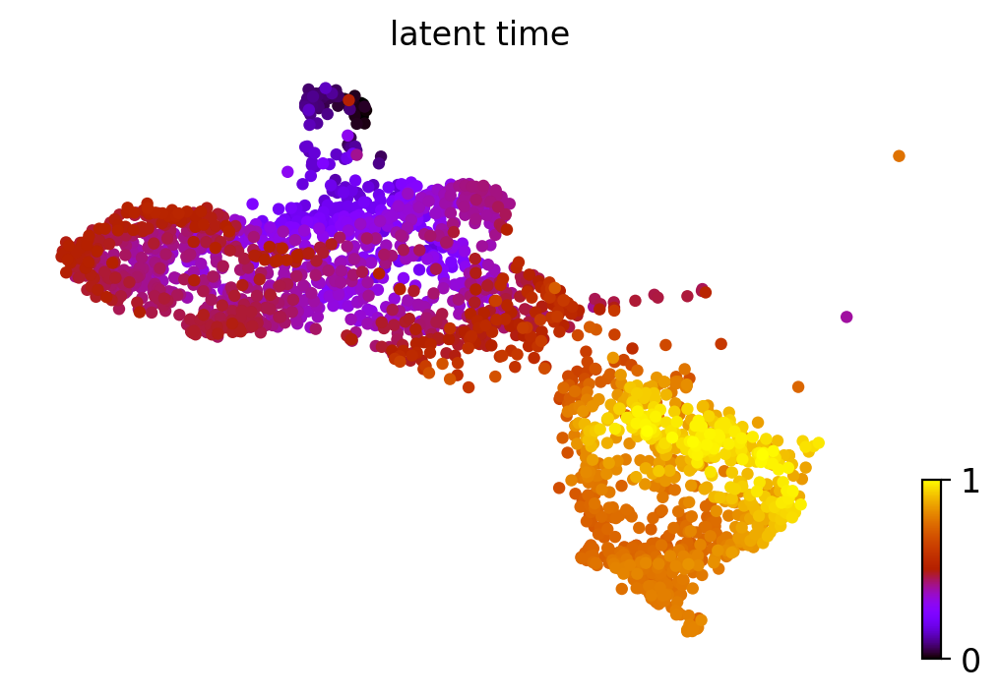

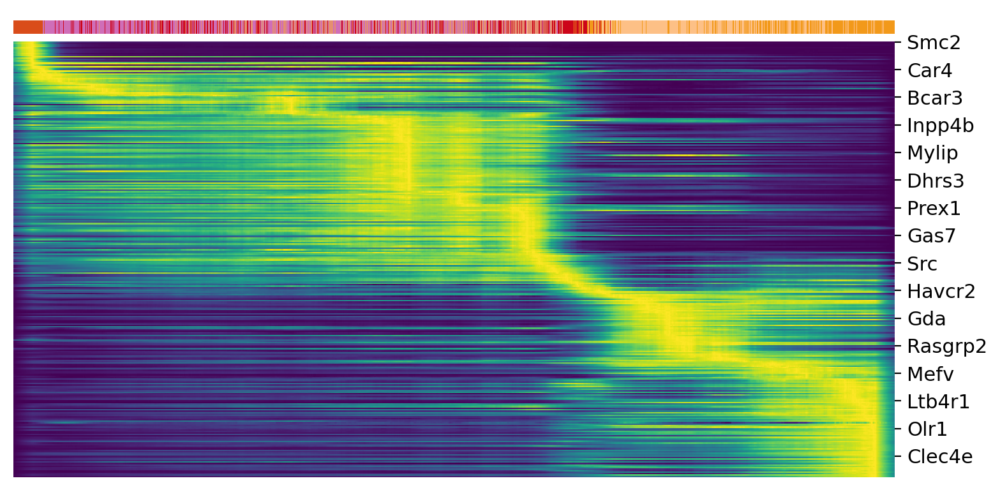

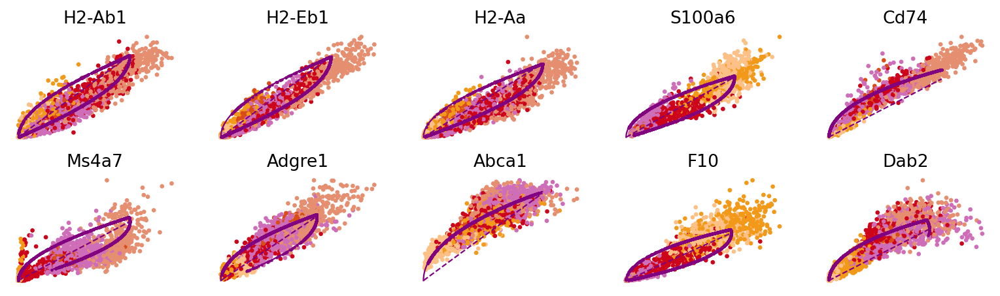

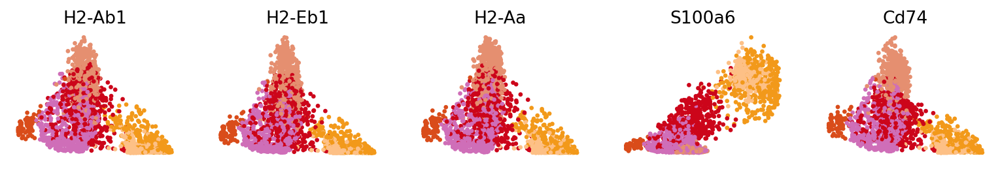

In [20]:
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80, colorbar=True)
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
# options(repr.plot.width=6, repr.plot.height=5)
scv.pl.heatmap(adata, var_names=top_genes, tkey='latent_time', n_convolve=100, col_color='celltype')
scv.pl.scatter(adata, basis=top_genes[:10], frameon=False, ncols=5,color='celltype')
# scv.pl.scatter(adata, basis=['Actn4', 'Ppp3ca', 'Cpe', 'Nnat'], frameon=False,color='celltype')
# scv.pl.scatter(adata, x='latent_time', y=['Cd47', 'Id1', 'Mmp8', 'Ifit3'], frameon=False,color='celltype')
scv.pl.scatter(adata, x='latent_time', y=top_genes[:5], frameon=False,color='celltype')

In [ ]:
#write scVelo analysis file
adata.write("./write/MDSC_subMac_scvelo_20210508.h5ad")
#read scVelo analysis file
# adata = scv.read("./write/MDSC_subMac_scvelo_20210508.h5ad")

## cellrank analysis

CellRank offers various ways to infuse directionality into single-cell data. Here, the directional information comes from RNA velocity, and we use this information to compute initial & terminal states as well as fate probabilities for the dynamical process of pancreatic development.

In [50]:
#read scVelo analysis file
adata = cr.read("./write/MDSC_subMac_scvelo_20210508.h5ad")

Creating forward `Lineage` from `adata.obsm['to_terminal_states']`
    Successfully loaded names
    Successfully loaded colors


In [21]:
adata

AnnData object with n_obs × n_vars = 2293 × 3000
    obs: 'Clusters', 'Lcelltype', 'Tcelltype', '_X', '_Y', 'allLabel', 'celltype', 'group', 'nCount_RNA', 'nFeature_RNA', 'newcluster1', 'obs_names', 'orig.ident', 'percent.mt', 'percent.rp', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'S_score', 'G2M_score', 'phase', 'clusters_gradients', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'var_names', 'gene_count_corr', 'means', 'dispersions', 'dispersions_norm', 'highly_variable', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'fit_r2'
    uns: 'celltype_colors', 'group_colors', 'neighbors', 'velocity_params'

In [22]:
adata.uns["celltype_colors"]=["#7fc67f","#e58f70",  "#ba7fb7","#5b86ab","#eb0875",'#ffe135']
adata.obs["celltype"]=adata.obs["celltype"].map({'mM01':'mMDSC1', 'mM02':'mMDSC2', 'mM03':'TAM1', 
       'mM04':'TAM2', 'mM05':'TAM3', 'mM06':'TAM4'})
adata.obs["celltype"]

1         TAM3
3       mMDSC1
5       mMDSC1
14      mMDSC1
15      mMDSC2
         ...  
7801      TAM2
7802    mMDSC1
7809      TAM3
7818    mMDSC2
7822      TAM1
Name: celltype, Length: 2293, dtype: category
Categories (6, object): ['mMDSC1', 'mMDSC2', 'TAM1', 'TAM2', 'TAM3', 'TAM4']

### Identify terminal states

接下来是通过CellRank计算初始状态和终末状态。

可以设置不同的mode来计算

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


Setting `softmax_scale=5.2847`


    Finish (0:00:05)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing eigendecomposition of the transition matrix


Adding `adata.uns['eig_fwd']`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `.macrostates_memberships`
        `.macrostates`
    Finish (0:00:00)
Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
    Finish
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


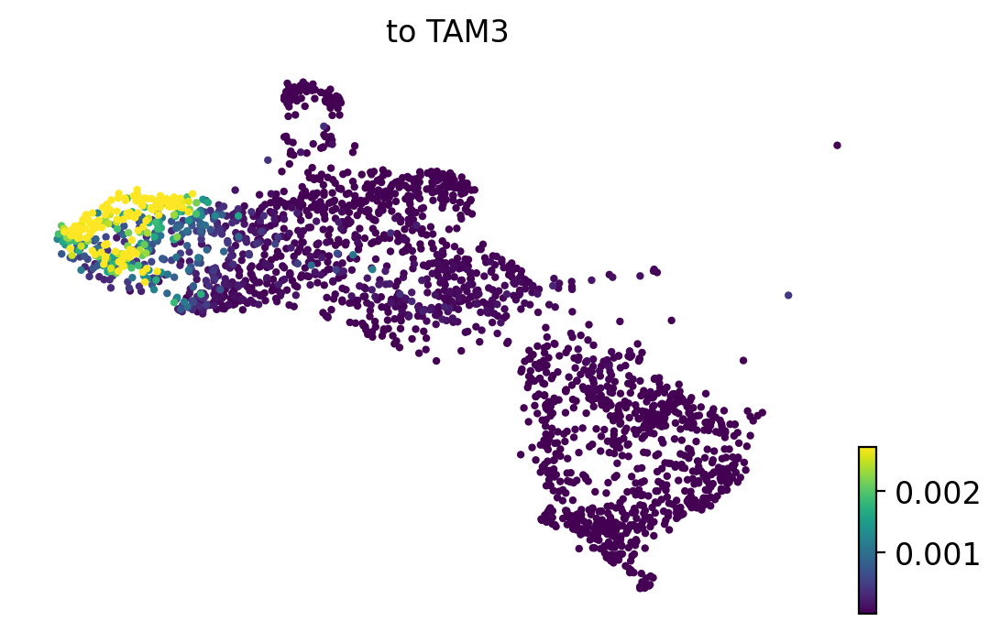

In [23]:
cr.tl.terminal_states(adata, cluster_key='celltype', weight_connectivities=0.2)
cr.pl.terminal_states(adata)

### Identify terminal states

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


Setting `softmax_scale=5.2847`


    Finish (0:00:07)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing eigendecomposition of the transition matrix


Adding `adata.uns['eig_bwd']`
       `.eigendecomposition`
    Finish (0:00:00)
Computing Schur decomposition
Adding `adata.uns['eig_bwd']`
       `.eigendecomposition`
       `.schur`
       `.schur_matrix`
    Finish (0:00:08)
Computing `2` macrostates
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:03)
Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`
       `adata.obsm['macrostates_bwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
    Finish
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments.

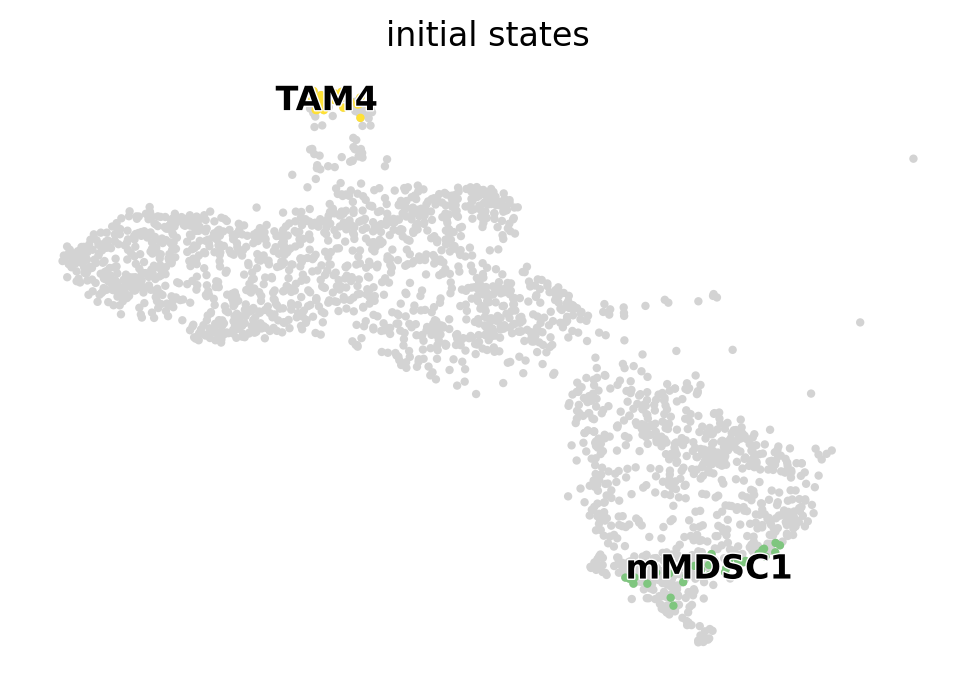

In [24]:
cr.tl.initial_states(adata, cluster_key='celltype')
cr.pl.initial_states(adata, discrete=True)

In [25]:
adata.uns["initial_states_names"]
adata.obs["initial_states"]

1       NaN
3       NaN
5       NaN
14      NaN
15      NaN
       ... 
7801    NaN
7802    NaN
7809    NaN
7818    NaN
7822    NaN
Name: initial_states, Length: 2293, dtype: category
Categories (2, object): ['TAM4', 'mMDSC1']

### Compute fate maps

处理完初始和终末状态之后，接下来是计算fate map的概率

Computing lineage probabilities towards terminal states
Computing absorption probabilities
Defaulting to `'gmres'` solver.


Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:00)
Adding lineages to `adata.obsm['to_terminal_states']`
    Finish (0:00:00)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


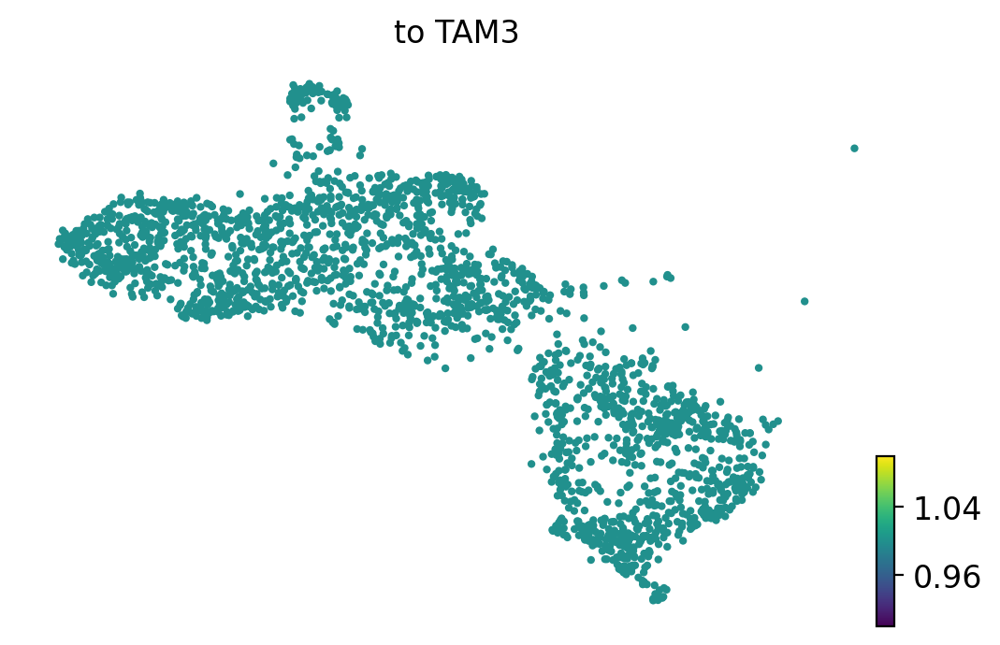

In [26]:
cr.tl.lineages(adata)
cr.pl.lineages(adata, same_plot=False)

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


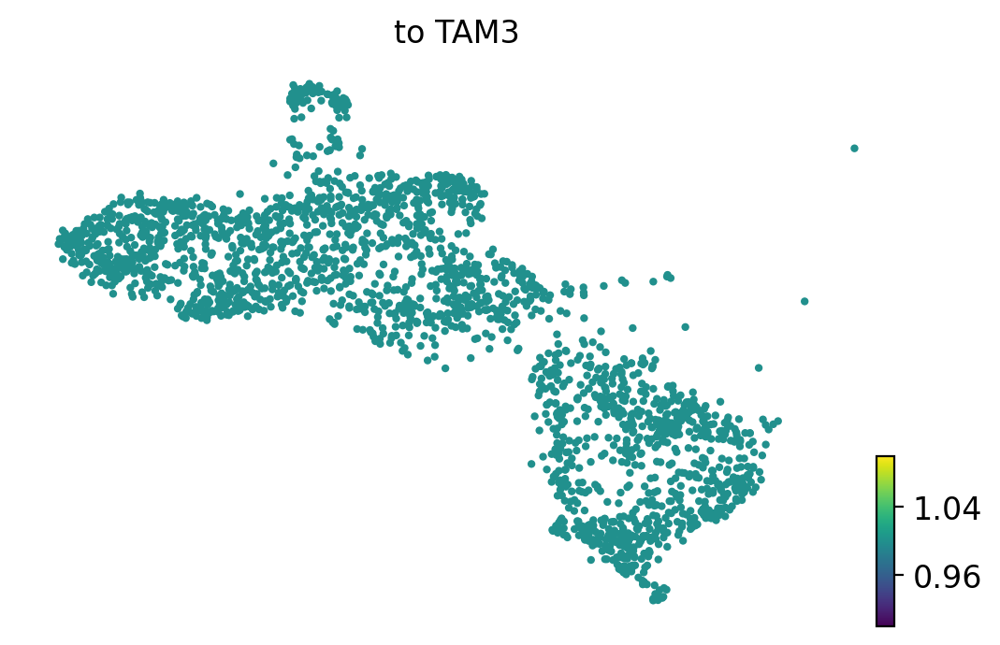

In [27]:
cr.pl.lineages(adata, same_plot=True)

### Directed PAGA

可以对cluster level的fate map和PAGA进行整合，得到directed PAGA：

In [28]:
scv.tl.recover_latent_time(adata, root_key='initial_states_probs', end_key='terminal_states_probs')

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


In [29]:
scv.tl.paga(adata, groups='celltype', root_key='initial_states_probs', end_key='terminal_states_probs',
            use_time_prior='velocity_pseudotime')

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

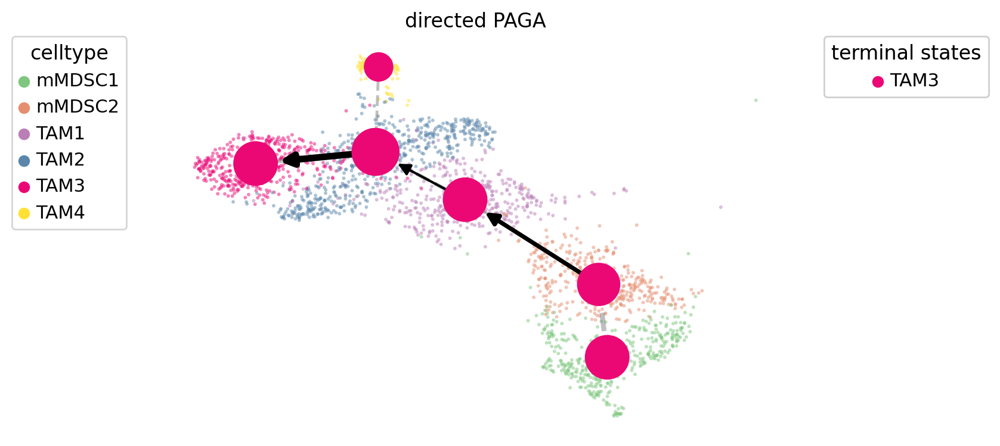

In [30]:
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

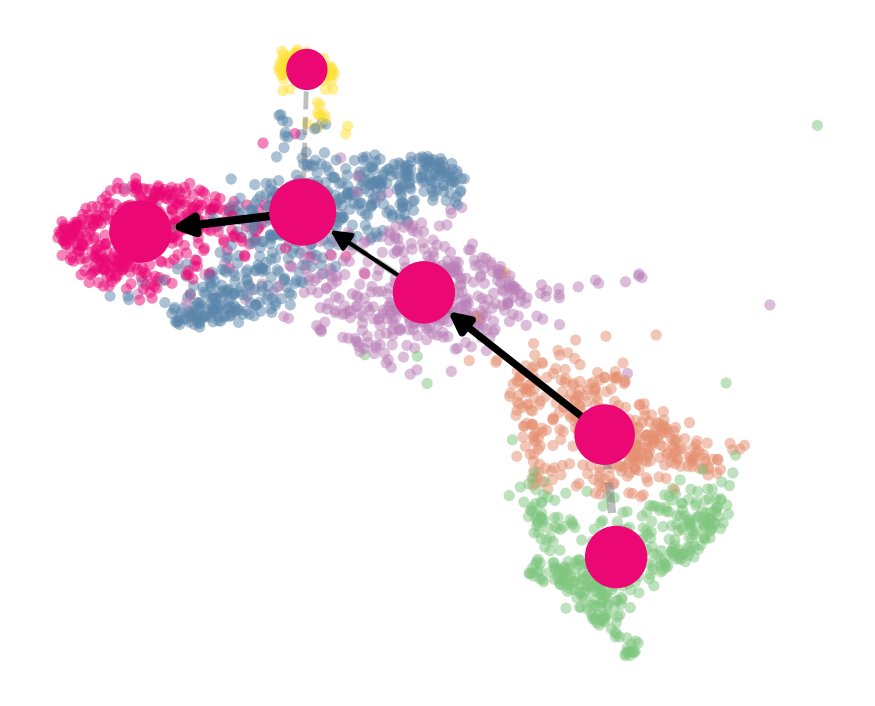

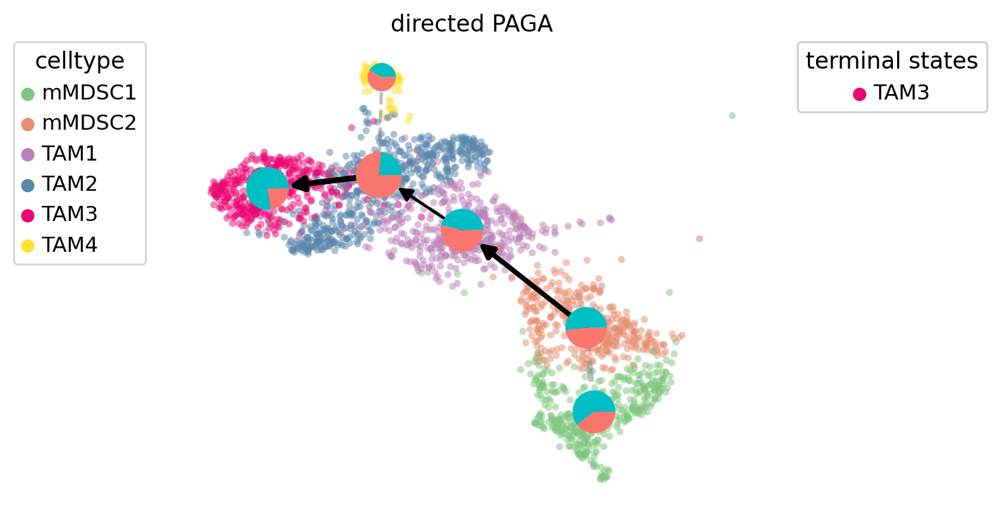

In [31]:
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',
                    legend_kwargs={'loc': 'none'}, legend_loc='none',size=65,
                    node_size_scale=3, edge_width_scale=1, max_edge_width=3, title='',
                    figsize=(5,4),save="./write/subMac_PAGA_celltype.pdf")
adata.uns["group_colors"]=["#00bfc4","#f8766d"]
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',colors=["group"],
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',size=55,
                    node_size_scale=3, edge_width_scale=1, max_edge_width=3, title='directed PAGA',
                    figsize=(5,4),save="./write/subMac_PAGA_group.pdf")

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_group_subMac_20210508.pdf


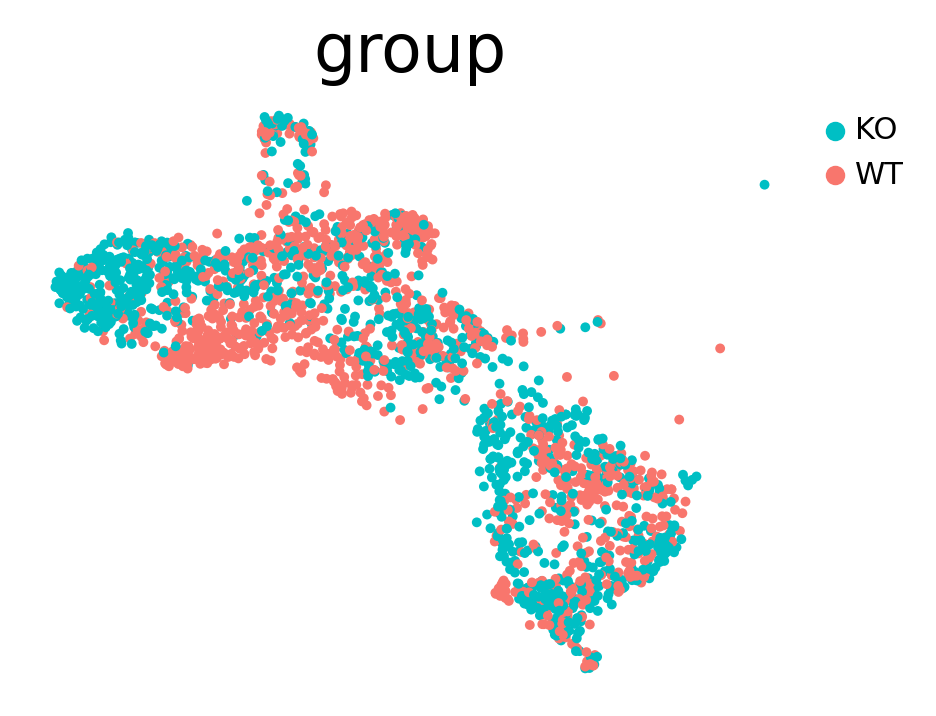

In [32]:
scv.pl.scatter(adata, color='group', fontsize=24, size=50,basis="umap",
               color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(5,4),save="umapplot_group_subMac_20210508.pdf")

### Compute lineage drivers

cellrank还可以计算lineage drivers

In [33]:
cr.tl.lineage_drivers(adata)

Computing correlations for lineages `['TAM3']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to TAM3 corr']`
    Finish (0:00:00)


,TAM3 corr,TAM3 pval,TAM3 qval,TAM3 ci low,TAM3 ci high
Dnase1l3,0.557738,2.203165e-199,6.609496e-196,0.528878,0.585309
Adamdec1,0.474116,2.715898e-134,4.073847e-131,0.441755,0.505244
Cd81,0.425124,1.262437e-104,1.262437e-101,0.390994,0.458086
Lag3,0.419937,8.662605e-102,6.496954e-99,0.385632,0.453083
Ccl8,0.415173,3.130830e-99,1.878498e-96,0.380709,0.448485
...,...,...,...,...,...
Emp3,-0.351597,3.823836e-69,3.373973e-67,-0.386962,-0.315199
Anxa2,-0.358593,4.142207e-72,4.008587e-70,-0.393748,-0.322391
S100a10,-0.368947,1.200504e-76,1.500630e-74,-0.403783,-0.333042
Tmsb10,-0.387354,3.588043e-85,6.331841e-83,-0.421604,-0.352001


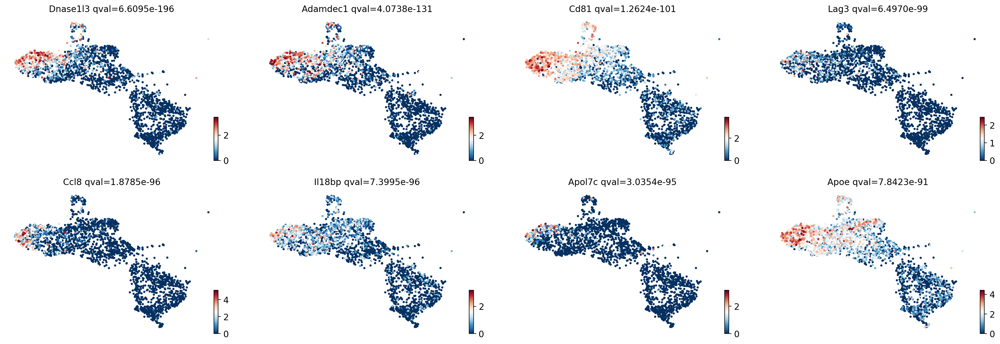

In [34]:
cr.pl.lineage_drivers(adata, lineage="TAM3", n_genes=8)

### Gene expression trends

另外，cellrank可以实现按照trajectory排序之后的基因表达热图

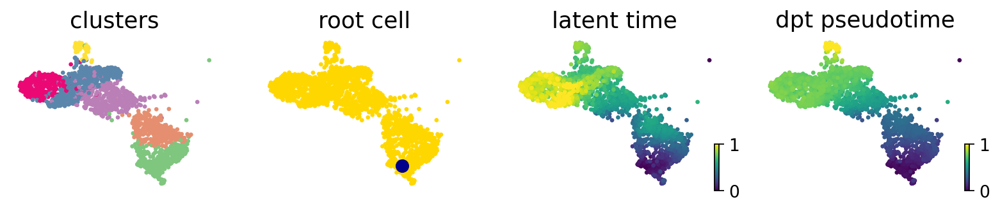

In [35]:
# compue dpt, starting from CellRank defined root cell
root_idx = np.where(adata.obs['initial_states'] == 'mMDSC1')[0][0]
adata.uns['iroot'] = root_idx
sc.tl.dpt(adata)

scv.pl.scatter(adata, color=['celltype', root_idx, 'latent_time', 'dpt_pseudotime'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['clusters', 'root cell', 'latent time', 'dpt pseudotime'])

Computing trends using `1` core(s)


    Finish (0:00:00)
Plotting trends


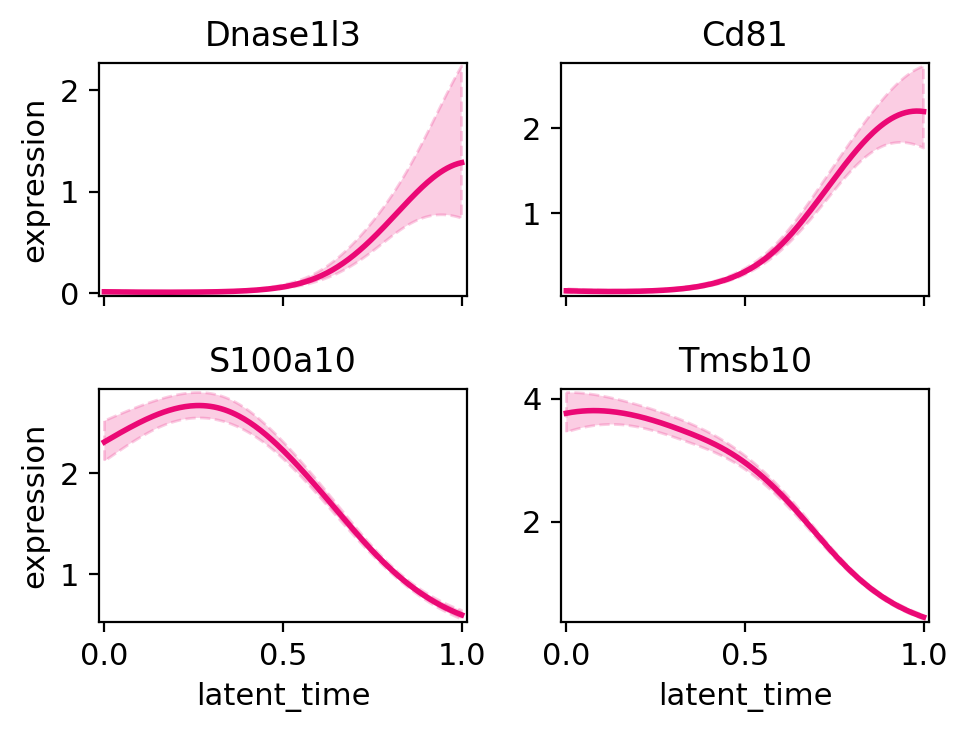

In [36]:
model = cr.ul.models.GAM(adata)
cr.pl.gene_trends(adata, model=model, data_key='X',
                  genes=['Dnase1l3','Cd81','S100a10','Tmsb10'], ncols=2,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  figsize=(5, 4), n_test_points=200,legend_loc=None)

Computing trends using `1` core(s)


did not converge
did not converge
did not converge


    Finish (0:00:20)


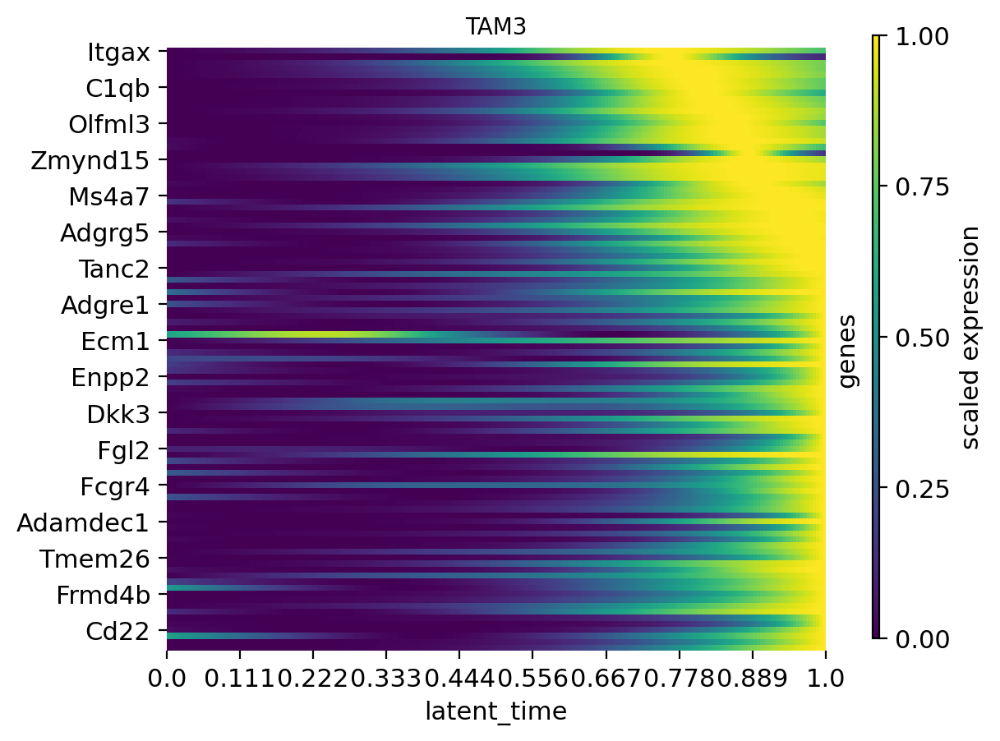

In [37]:
model = cr.ul.models.GAM(adata)
cr.pl.heatmap(adata, model, genes=adata.var['to TAM3 corr'].sort_values(ascending=False).index[:100],
              show_absorption_probabilities=False,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))

In [38]:
# options(repr.plot.width=6, repr.plot.height=5)
adata.var['to TAM3 corr']
adata.var['to TAM3 corr'].sort_values(ascending=False).index[:100]

Index(['Dnase1l3', 'Adamdec1', 'Cd81', 'Lag3', 'Ccl8', 'Il18bp', 'Apol7c',
       'Apoe', 'Tmem176a', 'H2-M2', 'Fcgr4', 'Tlr12', 'H2-Eb1', 'Tmem176b',
       'Lilra5', 'Ptgs1', 'Ms4a7', 'Asb2', 'Selenop', 'H2-Aa', 'Cd74',
       'Zmynd15', 'H2-Ab1', 'Fgl2', 'Vcam1', 'AW112010', 'C6', 'Gbp2b',
       'Art2b', 'Itga9', 'H2-DMb1', 'Pxdc1', 'Mmp13', 'Cd4', 'C1qc', 'Klra17',
       'Npl', 'Itm2b', 'C1qa', 'Cd22', 'Cd72', 'Aif1', 'Cp', 'Htra1', 'H2-DMa',
       'C1qb', 'Axl', 'Lair1', 'Mrc1', 'Camk2n1', 'Ly86', 'AC149090.1',
       'Malat1', 'Rtn1', 'Olfml3', 'Lgmn', 'Tmem26', 'Plxdc2', 'Rgs1', 'Pgf',
       'Tanc2', 'Fosb', 'Scn1b', 'C3ar1', 'Cd63', 'Gbp8', 'Abcc3', 'Pecam1',
       'Adgre1', 'Hpgds', 'Jaml', 'Cd300c2', 'Adgrg5', 'Tspan13', 'Sema6d',
       'Sec14l1', 'Cd83', 'Enpp2', 'Gns', 'Pmepa1', 'Serpina3g', 'Ciita',
       'Gbp7', 'Igf1', 'Atp8a1', 'Fcgrt', 'Epb41', 'Creb5', 'Ecm1', 'Dkk3',
       'Kcnj10', 'Herpud1', 'Pltp', 'Cadm1', 'Itgax', 'Rgs10', 'Acp5',
       'Acvrl1', 'Frmd4

In [49]:
#write scVelo analysis file
adata.write("./write/MDSC_subMac_scvelo_20210508.h5ad")
#read scVelo analysis file
# adata_Mac = cr.read("./write/MDSC_subMac_scvelo_20210508.h5ad")

### write out latent time of cells and lineage drive genes

In [4]:
#read scVelo analysis file
adata_Mac = cr.read("./write/MDSC_subMac_scvelo_20210508.h5ad")

Creating forward `Lineage` from `adata.obsm['to_terminal_states']`
    Successfully loaded names
    Successfully loaded colors


In [40]:
adata.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,...,clusters_gradients,root_cells,end_points,velocity_pseudotime,latent_time,terminal_states,terminal_states_probs,initial_states,initial_states_probs,dpt_pseudotime
1,2,Macrophage,Macrophage,14.686928,6.502661,mM05_TAM_Ccl8,TAM3,KO,28583,4725,...,S_score,0.041613,0.207622,0.945026,0.981069,NaN,1.974571e-02,NaN,0.869837,0.709398
3,1,Macrophage,Macrophage,-9.860976,-14.656569,mM01_mMDSC_Ccr2,mMDSC1,KO,14345,3240,...,S_score,0.002483,0.000013,0.011737,0.026201,NaN,8.407244e-06,NaN,0.999842,0.027185
5,10,Macrophage,Macrophage,28.387337,-18.500486,mM01_mMDSC_Ccr2,mMDSC1,WT,12833,2837,...,S_score,0.014318,0.000018,0.047482,0.171783,NaN,4.068895e-06,NaN,0.999443,0.129180
14,5,Macrophage,Macrophage,30.297018,-10.075708,mM01_mMDSC_Ccr2,mMDSC1,KO,16241,3114,...,S_score,0.198445,0.000007,0.014015,0.115080,NaN,9.749658e-07,NaN,0.999872,0.046440
15,7,Macrophage,Macrophage,14.302183,7.288043,mM02_mMDSC_Timp1,mMDSC2,WT,12180,2629,...,S_score,0.009094,0.000492,0.129532,0.438763,NaN,1.067050e-04,NaN,0.984087,0.298694
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7801,5,Macrophage,Macrophage,-13.967816,18.873419,mM04_TAM_Mfge8,TAM2,WT,25058,4735,...,S_score,0.066764,0.000021,0.809947,0.687584,NaN,4.930294e-04,NaN,0.908075,0.718382
7802,8,Macrophage,Macrophage,43.493626,5.100000,mM01_mMDSC_Ccr2,mMDSC1,WT,8582,2313,...,S_score,0.150896,0.000008,0.043207,0.205067,NaN,6.204232e-06,NaN,0.999268,0.109224
7809,0,Macrophage,Macrophage,-12.803620,17.121191,mM05_TAM_Ccl8,TAM3,KO,16569,3477,...,S_score,0.000322,0.664209,0.936370,0.890674,NaN,1.116345e-01,NaN,0.826994,0.725928
7818,5,Macrophage,Macrophage,-23.798615,-25.518599,mM02_mMDSC_Timp1,mMDSC2,KO,7944,2345,...,S_score,0.022554,0.000439,0.170145,0.401676,NaN,7.495537e-05,NaN,0.963312,0.305828


In [45]:
adata.obs[['obs_names',"velocity_pseudotime","dpt_pseudotime","latent_time"]]

,obs_names,velocity_pseudotime,dpt_pseudotime,latent_time
1,H389WT_out:TGCCGAGCACGCAGTCx,0.945026,0.709398,0.981069
3,H389WT_out:CTATAGGCAGGACTTTx,0.011737,0.027185,0.026201
5,H124KO_out:GACCGTGTCCAACACAx,0.047482,0.129180,0.171783
14,H389WT_out:TGGATCAAGATTGTGAx,0.014015,0.046440,0.115080
15,H124KO_out:TCTCAGCTCGCTAGCGx,0.129532,0.298694,0.438763
...,...,...,...,...
7801,H124KO_out:GGTCACGAGGGTTAGCx,0.809947,0.718382,0.687584
7802,H124KO_out:TTTCAGTGTTGTATGCx,0.043207,0.109224,0.205067
7809,H389WT_out:TTGTTGTGTAGAATACx,0.936370,0.725928,0.890674
7818,H382jia390KO_out:CTGCGAGGTCAATGGGx,0.170145,0.305828,0.401676


In [42]:
pseu_Mac=adata.obs[['obs_names','latent_time']]
pseu_Mac.to_csv("./write/MDSC_subMac_scvelo_pseudotime_20210508.csv")

In [6]:
adata_Mac.var.loc[['Irf8'],['to TAM3 corr',"to TAM3 qval"]]

,to TAM3 corr,to TAM3 qval
Irf8,0.137105,3.424405e-10


In [47]:
adata.var[['to TAM3 corr',"to TAM3 qval"]]
lineage_driveGenes = adata.var[['to TAM3 corr',"to TAM3 qval"]]

In [48]:
lineage_driveGenes.to_csv("./write/MDSC_subMac_scvelo_lineage_driveGene_20210508.csv")

In [20]:
[adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:15], adata_Mac.var['to TAM3 corr'].sort_values(ascending=True).index[:10]]

[Index(['Dnase1l3', 'Adamdec1', 'Cd81', 'Lag3', 'Ccl8', 'Il18bp', 'Apol7c',
        'Apoe', 'Tmem176a', 'H2-M2', 'Fcgr4', 'Tlr12', 'H2-Eb1', 'Tmem176b',
        'Lilra5'],
       dtype='object'),
 Index(['Alox5ap', 'Tmsb10', 'S100a10', 'Anxa2', 'Emp3', 'Fn1', 'S100a11',
        'Vim', 'S100a6', 'Lgals3'],
       dtype='object')]

Computing trends using `1` core(s)


    Finish (0:00:00)
Plotting trends
Computing trends using `1` core(s)


    Finish (0:00:00)


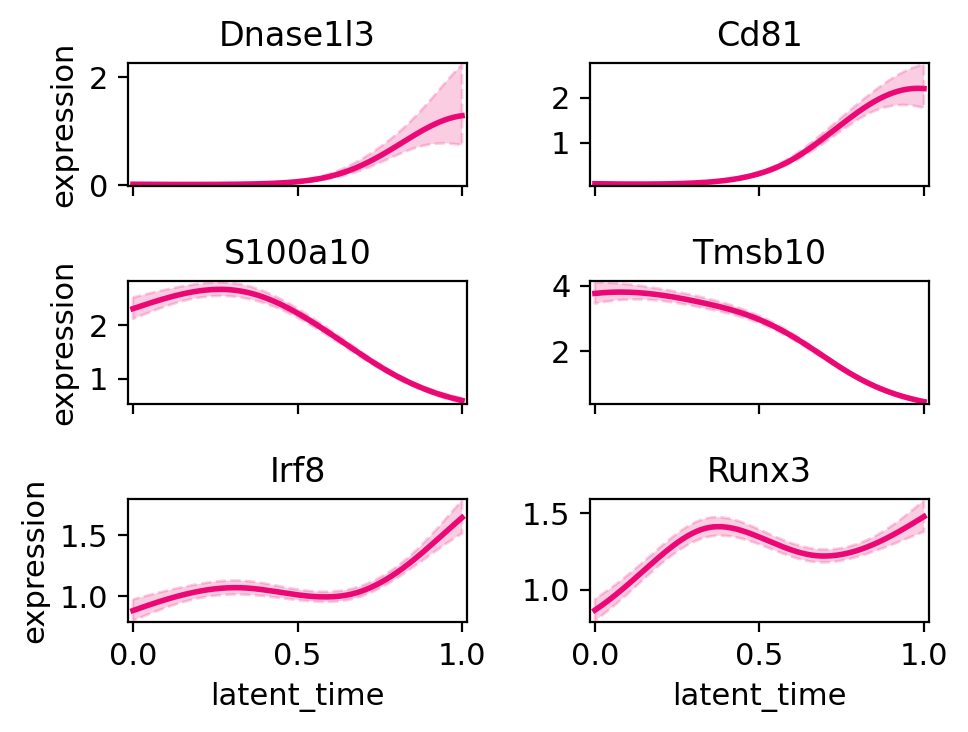

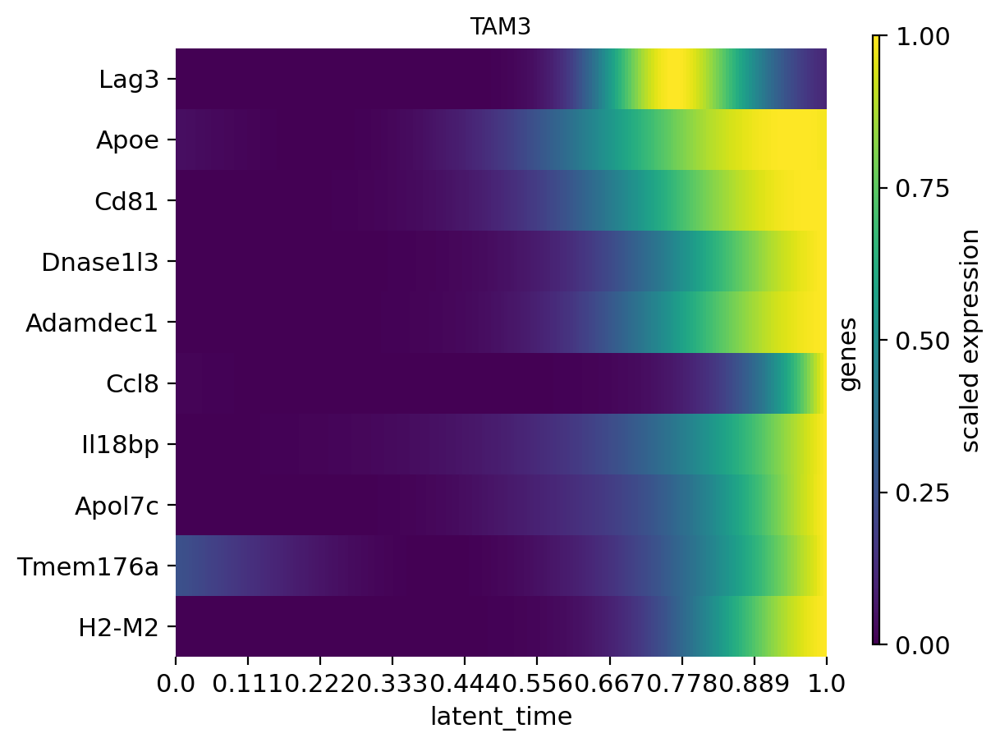

In [12]:
model = cr.ul.models.GAM(adata_Mac)
cr.pl.gene_trends(adata_Mac, model=model, data_key='X',
                  genes=['Dnase1l3','Cd81','S100a10','Tmsb10','Irf8','Runx3'], ncols=2,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  figsize=(5, 4), n_test_points=200,legend_loc=None)
cr.pl.heatmap(adata_Mac, model, genes=adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))

Computing trends using `1` core(s)


         to TAM3 corr  to TAM3 qval
Vcpip1       0.019411  4.860602e-01
Mcm3         0.025926  3.348099e-01
Ogfrl1       0.031308  2.313523e-01
Ptp4a1       0.016768  5.539303e-01
Neurl3       0.173824  5.727728e-16
...               ...           ...
Map3k15     -0.022374  4.129119e-01
Ap1s2       -0.124873  1.363991e-08
Piga        -0.018270  5.144802e-01
Arhgap6      0.024149  3.724580e-01
Gm47283      0.004198  8.926861e-01

[3000 rows x 2 columns]
568
174


did not converge


    Finish (0:00:12)


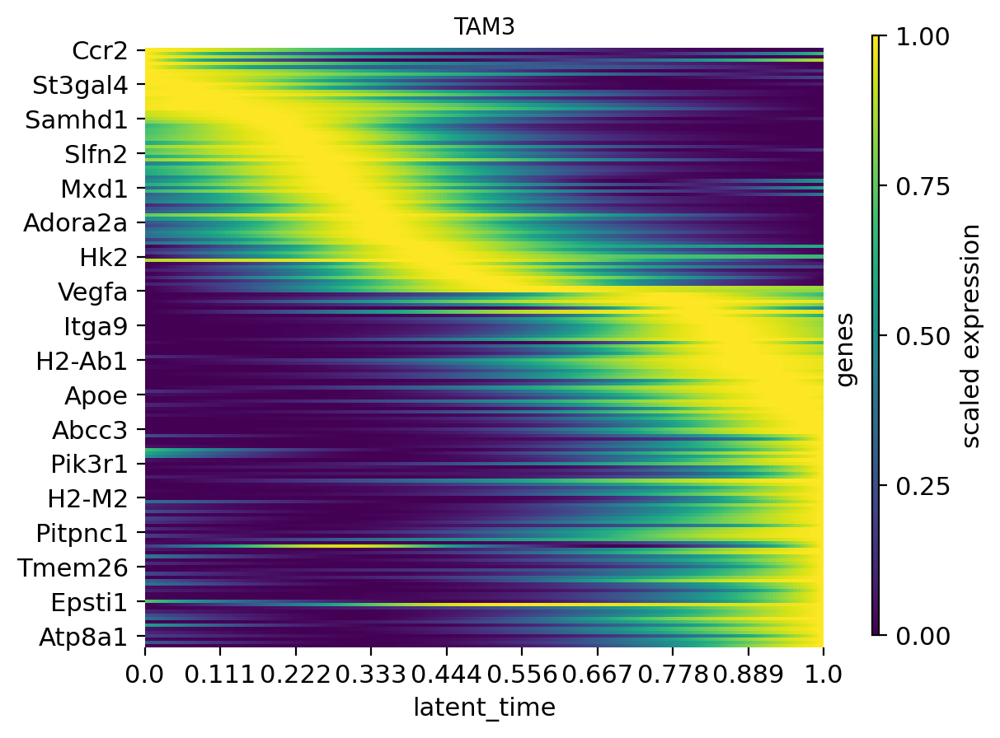

In [150]:
###画lineage相关基因的heatmap
lineage_driveGenes = adata_Mac.var[['to TAM3 corr',"to TAM3 qval"]]
print(lineage_driveGenes)

sublineage_driveGenes = lineage_driveGenes.loc[abs(lineage_driveGenes["to TAM3 corr"]) > 0.1, ]
Genes  = sublineage_driveGenes.sort_values(["to TAM3 corr"],ascending=False).index[:]
print(len(Genes))

top_genes = adata_Mac.var['fit_likelihood'].sort_values(ascending=False).index[:300]
#取交集
fitGenes = set(Genes).intersection(set(top_genes))
print(len(fitGenes))
#写出heatmap所用的基因
with open("./write/fitGenes174_heatmap_lineageTAM3.txt","w") as f:
    f.write(str(fitGenes))

model = cr.ul.models.GAM(adata_Mac)
cr.pl.heatmap(adata_Mac, model, genes=fitGenes, #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5),save="./write/fitGenes174_heatmap_lineageTAM3.pdf")

In [163]:
# with open("/home/wangxf/data/jupyter_notebook/Python/SCENIC/TFmouse_827.txt","r") as f:
with open("/data/jinwf/wangxf/tools/SCENIC/resources/mm_tfs.txt","r") as f:
    TFmouse = f.read().split("\n")

In [164]:
len(TFmouse)

1722

Computing trends using `1` core(s)


3000
293
         to TAM3 corr  to TAM3 qval
Fosb         0.276168  2.447214e-40
Creb5        0.236047  3.098091e-29
Got1         0.214101  4.922229e-24
Batf3        0.209843  4.368375e-23
Dab2         0.203237  1.172832e-21
...               ...           ...
Sema4a      -0.128096  5.409422e-09
Gadd45a     -0.130002  3.075396e-09
Prdx5       -0.142394  6.209390e-11
Arg1        -0.182825  1.305855e-17
Anxa1       -0.194120  8.652777e-20

[293 rows x 2 columns]


    Finish (0:00:11)


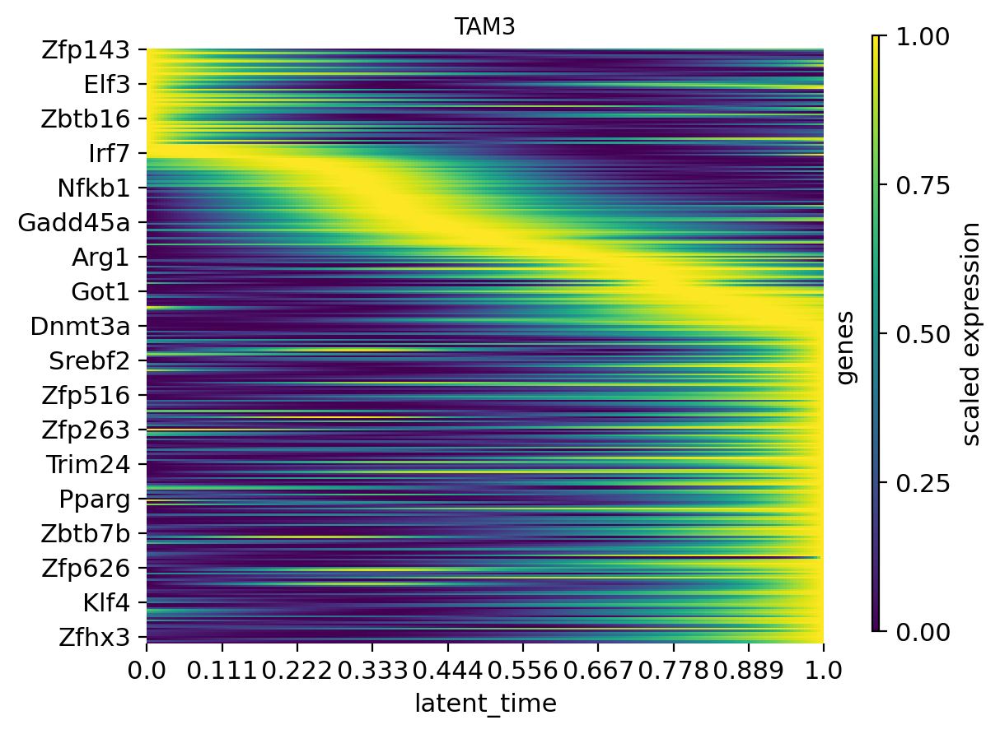

In [166]:
###画lineage相关TF的heatmap
lineage_driveGenes = adata_Mac.var[['to TAM3 corr',"to TAM3 qval"]]
# print(lineage_driveGenes)

sublineage_driveGenes = lineage_driveGenes.loc[abs(lineage_driveGenes["to TAM3 corr"]) > 0, ]
Genes  = sublineage_driveGenes.sort_values(["to TAM3 corr"],ascending=False).index[:]
print(len(Genes))

# top_genes = adata_Mac.var['fit_likelihood'].sort_values(ascending=False).index[:300]
#取交集
fitGenes = set(Genes).intersection(set(TFmouse))
print(len(fitGenes))

#写出heatmap所用的基因
x=lineage_driveGenes.loc[fitGenes]
print(x.sort_values(["to TAM3 corr"],ascending=False))
x.to_csv("./write/TFGenes293_heatmap_lineageTAM3.csv")

model = cr.ul.models.GAM(adata_Mac)
cr.pl.heatmap(adata_Mac, model, genes=fitGenes, #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5),save="./write/TFGenes293_heatmap_lineageTAM3.pdf")#

Computing trends using `1` core(s)


    Finish (0:00:00)
Plotting trends


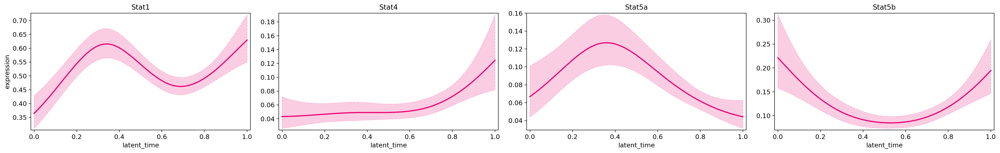

In [156]:
cr.pl.gene_trends(adata_Mac, model=model, data_key='X',
                  genes=['Stat1','Stat4','Stat5a','Stat5b'], ncols=4,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  n_test_points=200,legend_loc=None)

Computing trends using `1` core(s)


    Finish (0:00:00)


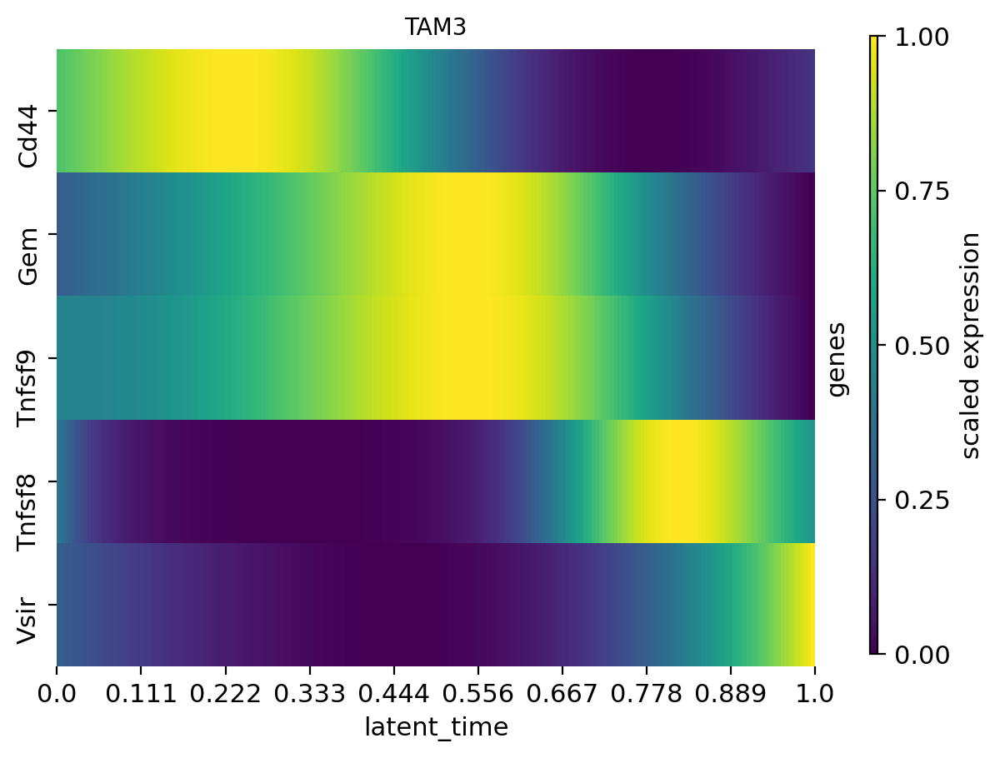

In [162]:
model = cr.ul.models.GAM(adata_Mac) #,'Cd274','Havcr2','Cd276','Cd86','Cd40'
cr.pl.heatmap(adata_Mac, model, genes=['Cd44','Vsir','Tnfsf8','Tnfsf9','Gem'], #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))#

Computing trends using `1` core(s)


did not converge
did not converge
did not converge


    Finish (0:00:18)


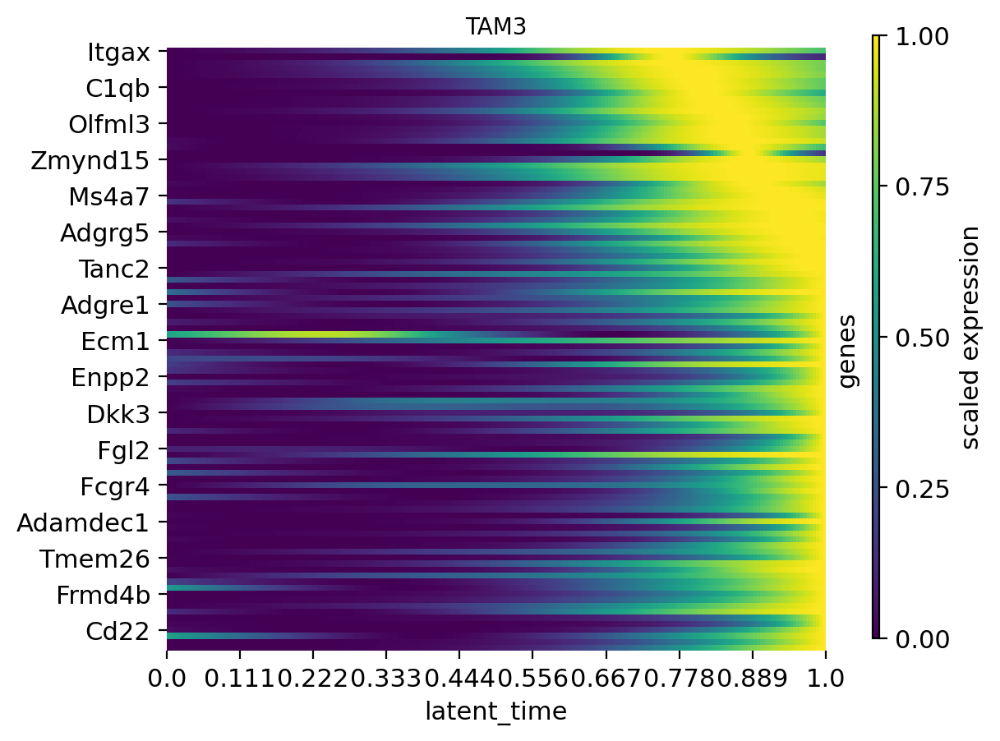

In [85]:
#lineage drive genes
cr.pl.heatmap(adata_Mac, model, genes=adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:100],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))

Computing trends using `1` core(s)


    Finish (0:00:00)
Plotting trends


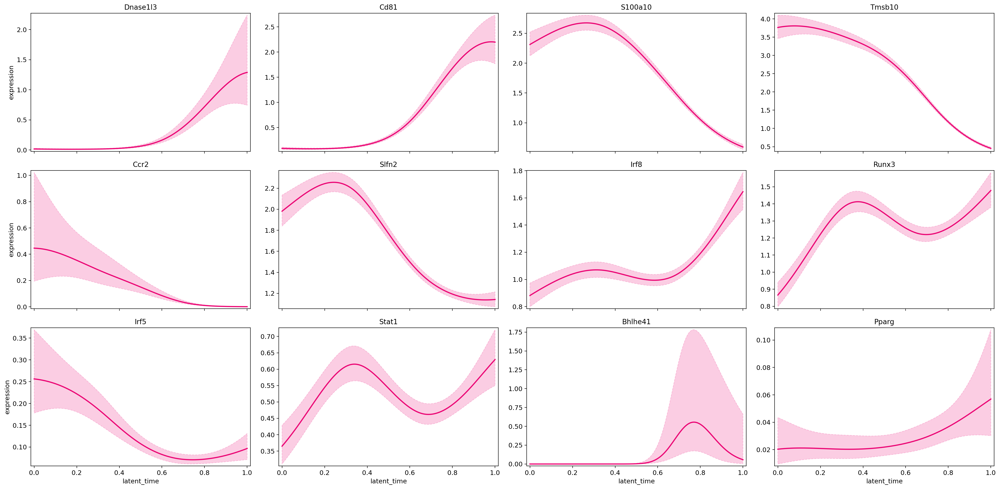

In [93]:
#top5 TFs
# "Irf8","T","Runx3","Irf5","Stat1","Esrra","Trp63","Bhlhe41","Pparg","Glis3"
cr.pl.gene_trends(adata_Mac, model=model, data_key='X',
                  genes=['Dnase1l3','Cd81','S100a10','Tmsb10','Ccr2','Slfn2',
                         "Irf8","Runx3","Irf5","Stat1","Bhlhe41","Pparg"], ncols=4,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  n_test_points=200,legend_loc=None)

Computing trends using `1` core(s)


    Finish (0:00:00)


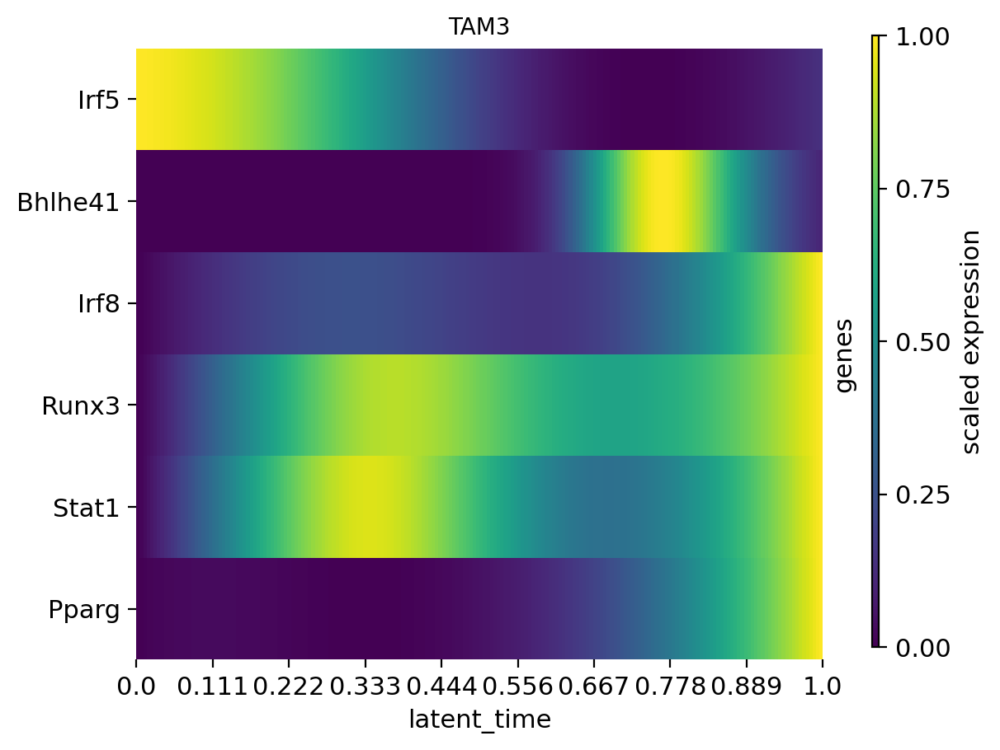

In [95]:
#top5 TFs
cr.pl.heatmap(adata_Mac, model, genes=["Irf8","Runx3","Irf5","Stat1","Bhlhe41","Pparg"], #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="TAM3", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))

# subNeu analysis

## scvelo analysis

In [83]:
# set colors
colfile = open("./datasource/CRCcolList.json","r")
CRCcolList = json.load(colfile)
print(CRCcolList)

{'mycol_MacDC': ['#fdc086', '#f2991a', '#cc051a', '#cf6eb8', '#e58f70', '#d94c1a', '#e6cc4c', '#b2d199', '#e76da2', '#72daf2'], 'mycol_Neu': ['#3387b5', '#beaed4', '#7fc97f', '#3abca5', '#dbb972', '#b49674', '#e26a46', '#be71af'], 'mycol_Mast': ['#d7ce96', '#e57371', '#c5aac3'], 'mycol_subMye': ['#fdc086', '#f2991a', '#cc051a', '#cf6eb8', '#e58f70', '#d94c1a', '#e6cc4c', '#b2d199', '#e76da2', '#72daf2', '#3387b5', '#beaed4', '#7fc97f', '#3abca5', '#dbb972', '#b49674', '#e26a46', '#be71af', '#d7ce96', '#e57371', '#c5aac3'], 'TcelltypeCols': ['#91d5e5', '#d71e26', '#d9a86a', '#f6b62a', '#be71af', '#f5797c', '#3abca5', '#8c9fd2', '#87c963'], 'tissueCols': ['#fd8b7b', '#93b9d8', '#febe65']}


In [49]:
adata_subMye_all = scv.read_loom("./write/MDSC_subMye_scvelo.loom")

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/anndata/_core/anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [46]:
adata_subMye_all.obs["Tcelltype"].unique()

array(['Neutrophil', 'Macrophage', 'Mast cell', 'DC'], dtype=object)

In [47]:
subName_Neu = adata_subMye_all.obs.loc[adata_subMye_all.obs["Tcelltype"]=="Neutrophil"]._stat_axis.values.tolist()
adata_Neu = adata_subMye_all[subName_Neu,]
adata_Neu.uns["celltype_colors"]=CRCcolList["mycol_Neu"]
adata_Neu

Trying to set attribute `.uns` of view, copying.


AnnData object with n_obs × n_vars = 4356 × 31053
    obs: 'Clusters', 'Lcelltype', 'Tcelltype', '_X', '_Y', 'allLabel', 'celltype', 'group', 'nCount_RNA', 'nFeature_RNA', 'newcluster1', 'obs_names', 'orig.ident', 'percent.mt', 'percent.rp'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'var_names'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [49]:
adata_Neu.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,newcluster1,obs_names,orig.ident,percent.mt,percent.rp
0,4,Neutrophil,Neutrophil,-28.611614,-8.926436,mM18_gMDSC_Prdx1,mM18,KO,1016,324,mM18,H389WT_out:TCCGATCGTCGTACTAx,H389KO,1.673228,4.625984
2,2,Neutrophil,Neutrophil,22.081251,21.456640,mM14_gMDSC_Clec5a,mM14,WT,986,481,mM14,H124KO_out:CATTTCATCTAAACGCx,H124WT,3.144016,2.636917
4,3,Neutrophil,Neutrophil,-7.907442,49.644989,mM14_gMDSC_Clec5a,mM14,KO,4366,1042,mM14,H389WT_out:ATGGGTTCATGAAAGTx,H389KO,1.488777,2.175905
7,1,Neutrophil,Neutrophil,14.634216,-25.281103,mM18_gMDSC_Prdx1,mM18,WT,1507,461,mM18,H124KO_out:CAACGATCATGTTCGAx,H124WT,1.194426,3.583278
8,5,Neutrophil,Neutrophil,-7.741055,24.950951,mM12_gMDSC_Mmp8,mM12,WT,3694,1006,mM12,H124KO_out:TCTCAGCTCTTGTTACx,H124WT,0.541419,3.844071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7816,6,Neutrophil,Neutrophil,-7.143039,40.060303,mM18_gMDSC_Prdx1,mM18,WT,3024,720,mM18,H124KO_out:CATACAGCAACTGGTTx,H124WT,0.429894,1.719577
7817,9,Neutrophil,Neutrophil,-5.622938,31.742191,mM16_gMDSC_H2-Q10,mM16,KO,2214,833,mM16,H382jia390KO_out:TCGAAGTCAGCTGTTAx,H382jia390KO,1.219512,6.187895
7819,3,Neutrophil,Neutrophil,8.278304,21.180367,mM18_gMDSC_Prdx1,mM18,KO,7060,1172,mM18,H389WT_out:TTCGGTCCATGGATCTx,H389KO,50.920680,2.195467
7820,2,Neutrophil,Neutrophil,15.028574,7.519513,mM12_gMDSC_Mmp8,mM12,KO,6566,1337,mM12,H389WT_out:CCTACGTAGGAGATAGx,H389KO,1.248858,2.558635


In [50]:
adata = adata_Neu

In [52]:
adata

AnnData object with n_obs × n_vars = 4356 × 31053
    obs: 'Clusters', 'Lcelltype', 'Tcelltype', '_X', '_Y', 'allLabel', 'celltype', 'group', 'nCount_RNA', 'nFeature_RNA', 'newcluster1', 'obs_names', 'orig.ident', 'percent.mt', 'percent.rp'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'var_names'
    uns: 'celltype_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [53]:
adata.obs["celltype"]=adata.obs["celltype"].map({'mM11':'gMDSC1', 'mM12':'gMDSC2', 'mM13':'gMDSC3', 
       'mM14':'gMDSC4', 'mM15':'gMDSC5', 'mM16':'gMDSC6', 'mM17':'gMDSC7', 'mM18':'gMDSC8'})
adata.obs["celltype"].unique()
# adata.obs["celltype"]=adata.obs["celltype"].map({'gMDSC1':'gMDSC2', 'gMDSC2':'gMDSC2', 'gMDSC3':'gMDSC3', 
#        'gMDSC4':'gMDSC4', 'gMDSC5':'gMDSC5', 'gMDSC6':'gMDSC6', 'gMDSC7':'gMDSC7', 'gMDSC8':'gMDSC8'})
# adata.obs["celltype"].unique()

array(['gMDSC8', 'gMDSC4', 'gMDSC2', 'gMDSC5', 'gMDSC3', 'gMDSC6',
       'gMDSC7', 'gMDSC1'], dtype=object)

In [54]:
# filter genes and cells
scv.pp.filter_and_normalize(adata, min_shared_counts=10, n_top_genes=3000)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

# velocity analysis
scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)

Filtered out 27119 genes that are detected 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Extracted 3000 highly variable genes.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:09) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [55]:
# using dynamic model
scv.tl.recover_dynamics(adata)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)

recovering dynamics (using 1/192 cores)



    finished (0:03:54) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [56]:
adata.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,newcluster1,obs_names,orig.ident,percent.mt,percent.rp,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,velocity_self_transition
0,4,Neutrophil,Neutrophil,-28.611614,-8.926436,mM18_gMDSC_Prdx1,gMDSC8,KO,1016,324,mM18,H389WT_out:TCCGATCGTCGTACTAx,H389KO,1.673228,4.625984,757,443,757.0,2476.476074,0.467674
2,2,Neutrophil,Neutrophil,22.081251,21.456640,mM14_gMDSC_Clec5a,gMDSC4,WT,986,481,mM14,H124KO_out:CATTTCATCTAAACGCx,H124WT,3.144016,2.636917,742,692,742.0,2663.638428,0.200000
4,3,Neutrophil,Neutrophil,-7.907442,49.644989,mM14_gMDSC_Clec5a,gMDSC4,KO,4366,1042,mM14,H389WT_out:ATGGGTTCATGAAAGTx,H389KO,1.488777,2.175905,3519,1264,3519.0,2744.614502,0.341517
7,1,Neutrophil,Neutrophil,14.634216,-25.281103,mM18_gMDSC_Prdx1,gMDSC8,WT,1507,461,mM18,H124KO_out:CAACGATCATGTTCGAx,H124WT,1.194426,3.583278,1218,262,1218.0,2706.051758,0.384543
8,5,Neutrophil,Neutrophil,-7.741055,24.950951,mM12_gMDSC_Mmp8,gMDSC2,WT,3694,1006,mM12,H124KO_out:TCTCAGCTCTTGTTACx,H124WT,0.541419,3.844071,3059,627,3059.0,2775.379150,0.130973
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7816,6,Neutrophil,Neutrophil,-7.143039,40.060303,mM18_gMDSC_Prdx1,gMDSC8,WT,3024,720,mM18,H124KO_out:CATACAGCAACTGGTTx,H124WT,0.429894,1.719577,2653,503,2653.0,2739.975830,0.076975
7817,9,Neutrophil,Neutrophil,-5.622938,31.742191,mM16_gMDSC_H2-Q10,gMDSC6,KO,2214,833,mM16,H382jia390KO_out:TCGAAGTCAGCTGTTAx,H382jia390KO,1.219512,6.187895,1755,676,1755.0,2669.674072,0.357615
7819,3,Neutrophil,Neutrophil,8.278304,21.180367,mM18_gMDSC_Prdx1,gMDSC8,KO,7060,1172,mM18,H389WT_out:TTCGGTCCATGGATCTx,H389KO,50.920680,2.195467,3399,1250,3399.0,2219.851318,0.405194
7820,2,Neutrophil,Neutrophil,15.028574,7.519513,mM12_gMDSC_Mmp8,gMDSC2,KO,6566,1337,mM12,H389WT_out:CCTACGTAGGAGATAGx,H389KO,1.248858,2.558635,5351,1212,5351.0,2769.078125,0.146525


In [57]:
adata.var

,Accession,Chromosome,End,Start,Strand,var_names,gene_count_corr,means,dispersions,dispersions_norm,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
13,ENSMUSG00000045210,1,9748382,9718622,-,Vcpip1,-0.0338,0.080248,0.345004,-0.092090,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.287403
18,ENSMUSG00000067851,1,10232670,10137571,-,Arfgef1,-0.0450,0.180000,0.395777,0.094704,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.556757
23,ENSMUSG00000005886,1,13374083,13139105,-,Ncoa2,-0.0324,0.075910,0.283122,-0.319759,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.758594
25,ENSMUSG00000025937,1,13660546,13623330,-,Lactb2,-0.0467,0.012611,0.807413,1.609130,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.292792
52,ENSMUSG00000026158,1,23397772,23366424,-,Ogfrl1,-0.0250,0.368144,0.511849,-0.075443,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.069355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30264,ENSMUSG00000025261,X,151935417,151800807,+,Huwe1,-0.0173,0.049321,0.219569,-0.553572,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.272427
30266,ENSMUSG00000041133,X,152062694,152016428,+,Smc1a,-0.0063,0.084440,0.615411,0.902749,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.032964
30268,ENSMUSG00000025332,X,152274535,152233020,+,Kdm5c,-0.0216,0.059436,0.291720,-0.288124,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.475907
30288,ENSMUSG00000044150,X,159593081,159526688,+,Bclaf3,-0.0225,0.057757,0.297175,-0.268057,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.293847


In [58]:
adata.var.index = adata.var['var_names'].tolist()#修改行名
# adata.var=adata.var.drop(['var_names'], axis=1)#删除dataframe某一列
adata.var

,Accession,Chromosome,End,Start,Strand,gene_count_corr,means,dispersions,dispersions_norm,highly_variable,...,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling,fit_r2
Vcpip1,ENSMUSG00000045210,1,9748382,9718622,-,-0.0338,0.080248,0.345004,-0.092090,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.287403
Arfgef1,ENSMUSG00000067851,1,10232670,10137571,-,-0.0450,0.180000,0.395777,0.094704,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.556757
Ncoa2,ENSMUSG00000005886,1,13374083,13139105,-,-0.0324,0.075910,0.283122,-0.319759,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.758594
Lactb2,ENSMUSG00000025937,1,13660546,13623330,-,-0.0467,0.012611,0.807413,1.609130,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.292792
Ogfrl1,ENSMUSG00000026158,1,23397772,23366424,-,-0.0250,0.368144,0.511849,-0.075443,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.069355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Huwe1,ENSMUSG00000025261,X,151935417,151800807,+,-0.0173,0.049321,0.219569,-0.553572,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.272427
Smc1a,ENSMUSG00000041133,X,152062694,152016428,+,-0.0063,0.084440,0.615411,0.902749,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.032964
Kdm5c,ENSMUSG00000025332,X,152274535,152233020,+,-0.0216,0.059436,0.291720,-0.288124,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1.475907
Bclaf3,ENSMUSG00000044150,X,159593081,159526688,+,-0.0225,0.057757,0.297175,-0.268057,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.293847


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_subNeu_20210508.pdf


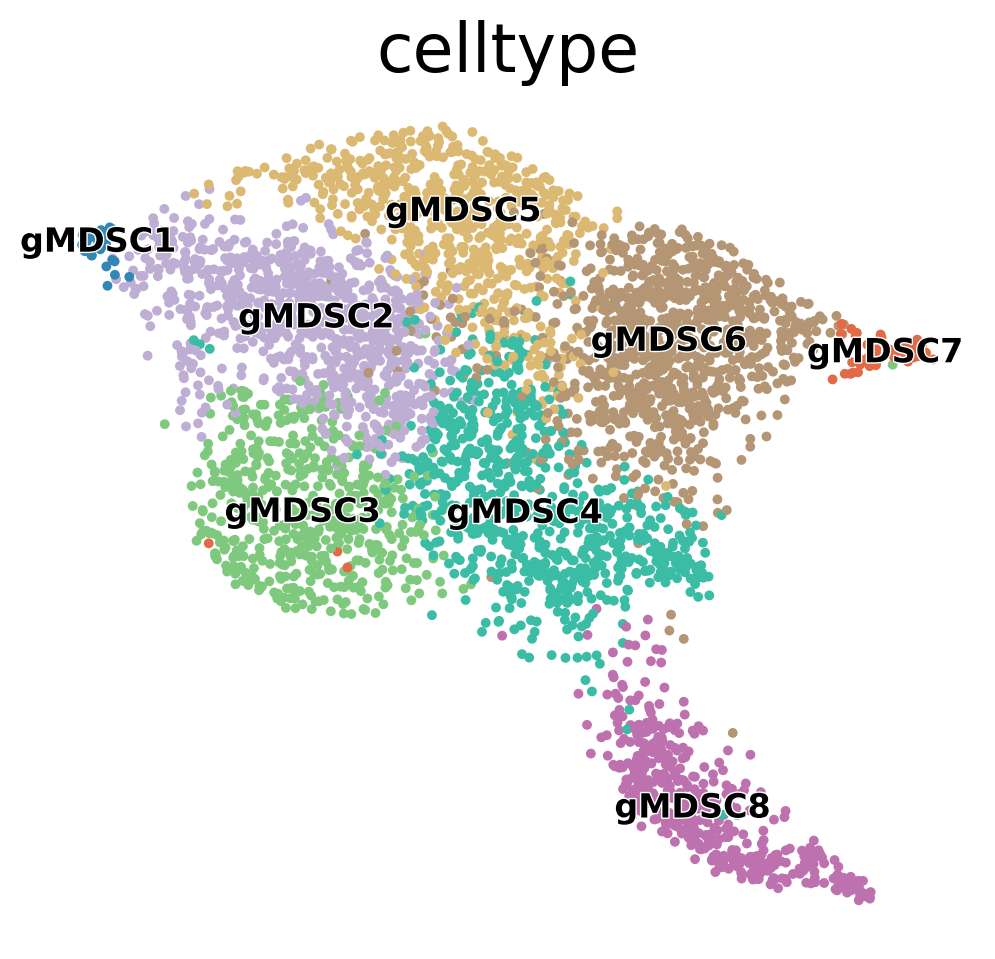

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_stream_subNeu_20210508.pdf


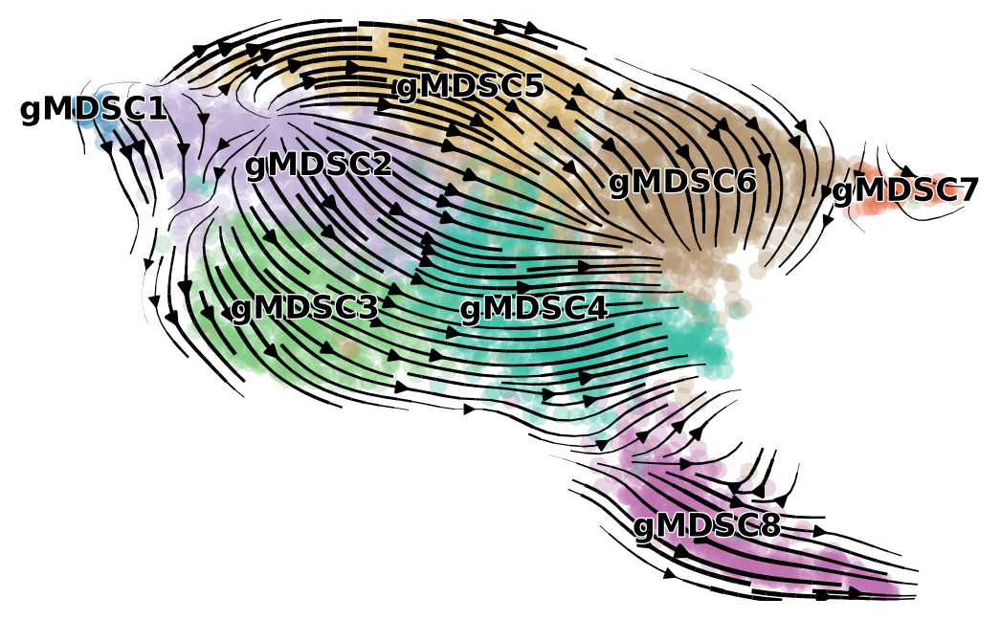

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_grid_subNeu_20210508.pdf


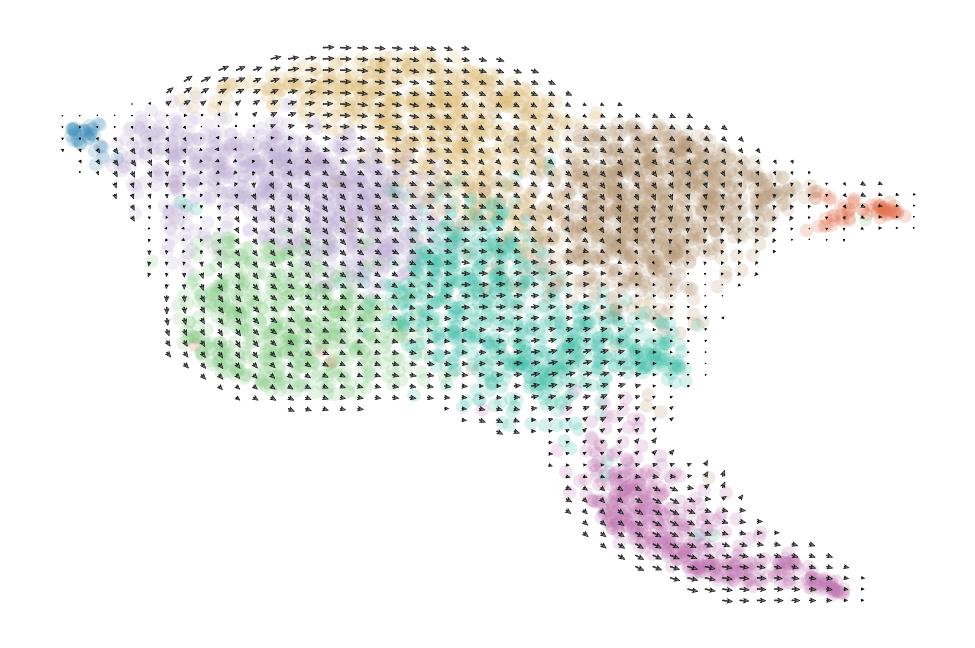

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


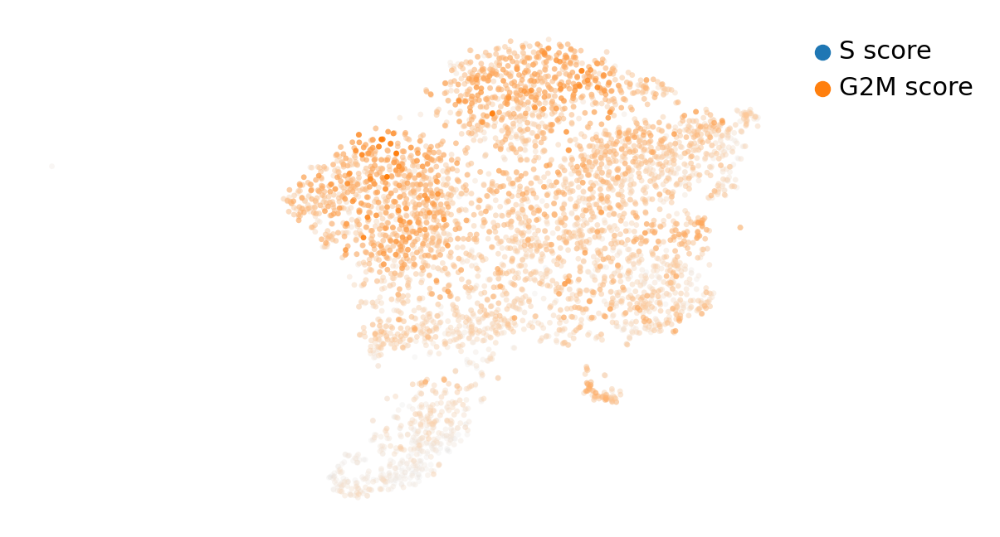

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
saving figure to file ./figures/scvelo_RootEndplot_subNeu_20210508.pdf


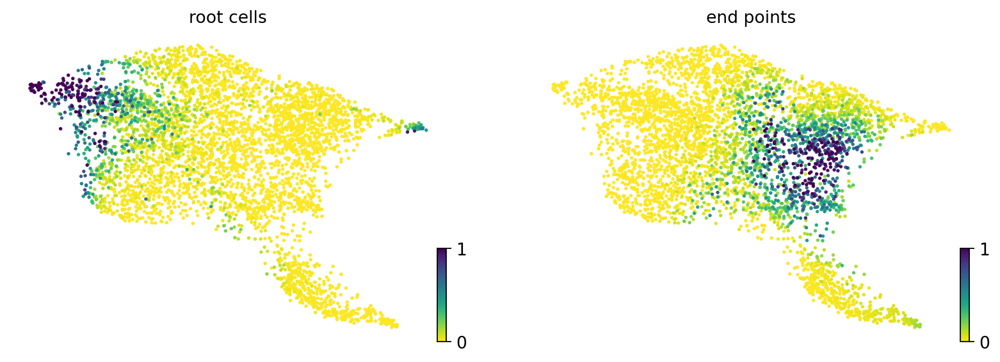

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_pseudotime_subNeu_20210508.pdf


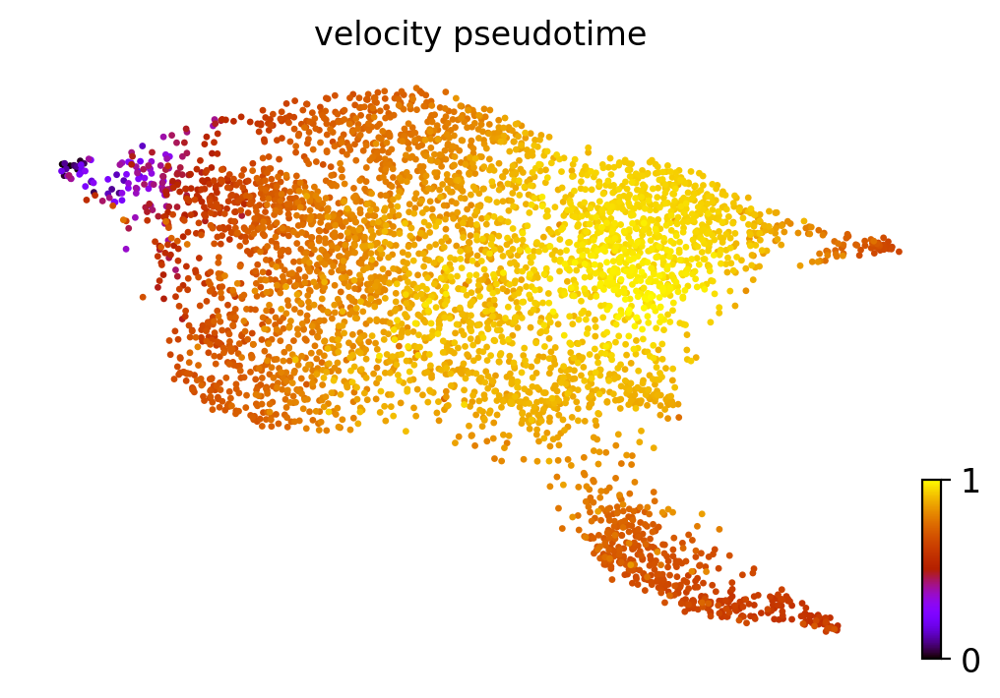

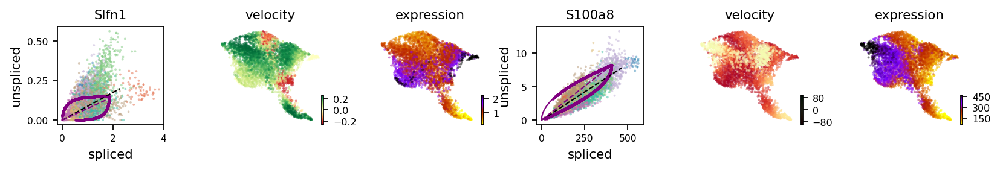

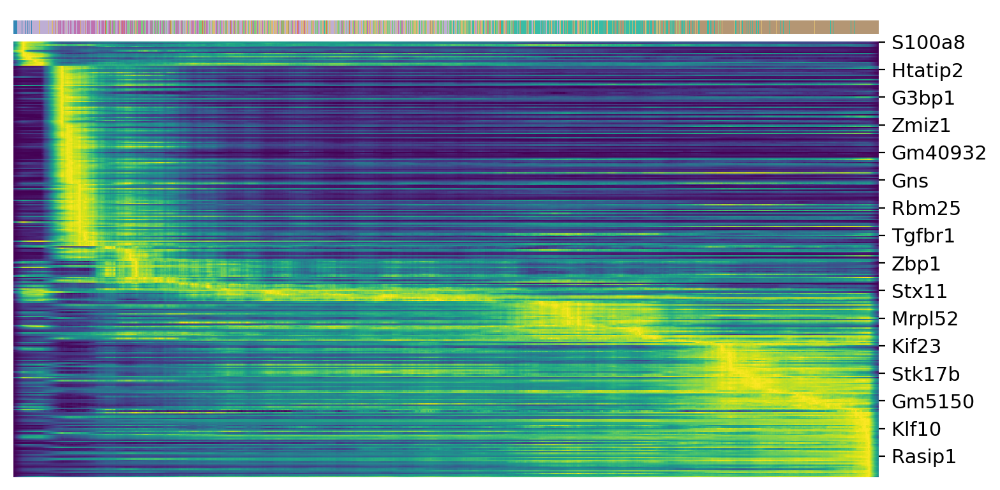

In [59]:
# tsne and umap plot 
# scv.pl.scatter(adata, color='celltype', fontsize=24, size=50,basis="tsne",
#                color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(6,5.6),save="tsneplot_subMac_20210508.pdf")
scv.pl.scatter(adata, color='celltype', fontsize=24, size=50,basis="umap",
               color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(6,5.6),save="umapplot_subNeu_20210508.pdf")
# velocity embedding stream and grid plot ##30PCs+3000genes
scv.pl.velocity_embedding_stream(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',save="umapplot_stream_subNeu_20210508.pdf")
scv.pl.velocity_embedding_grid(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',save="umapplot_grid_subNeu_20210508.pdf")
# scv.pl.velocity_embedding_stream(adata, basis='tsne', title='', smooth=.8, min_mass=2,color='celltype')
# scv.pl.velocity_embedding_grid(adata, basis='tsne', title='', smooth=.8, min_mass=2,color='celltype')
# cellcycle
scv.tl.score_genes_cell_cycle(adata)
scv.pl.scatter(adata,color_gradients=['S_score','G2M_score'],basis="tsne",smooth=True,perc=[5,95])
# find root and terminal cell
scv.tl.terminal_states(adata)
scv.pl.scatter(adata,color=['root_cells','end_points'],basis='umap',save="RootEndplot_subNeu_20210508.pdf")
# pseudotime anaysis and plot
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata,color='velocity_pseudotime',cmap='gnuplot',basis='umap',save="pseudotime_subNeu_20210508.pdf")
# mapping special genes on velocity plot
var_names = ['Slfn1','S100a8']
scv.pl.velocity(adata,var_names=var_names,colorbar=True,ncols=2,basis='umap',color="celltype")
# heatmap along velocity pseudotime
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(adata, var_names=top_genes,sortby='velocity_pseudotime', n_convolve=100, col_color='celltype')

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_grid_subNeu_20210508.pdf


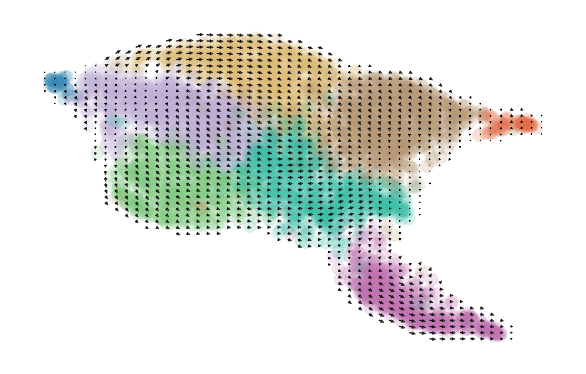

In [60]:
scv.pl.velocity_embedding_grid(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',figsize=(3.5,2.2),save="umapplot_grid_subNeu_20210508.pdf")

In [61]:
top_genes

Index(['S100a6', 'S100a8', 'Stx11', 'Pim1', 'Nlrp3', 'Esd', 'Fosl1', 'Rel',
       'Ptafr', 'Selplg',
       ...
       'Vps37a', 'Cipc', 'Ewsr1', 'Elf2', 'Egln1', 'Gnpda1', 'Tapt1', 'Hk2',
       'Snx5', 'Spcs2'],
      dtype='object', length=300)

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_stream_subNeu_20210508.pdf


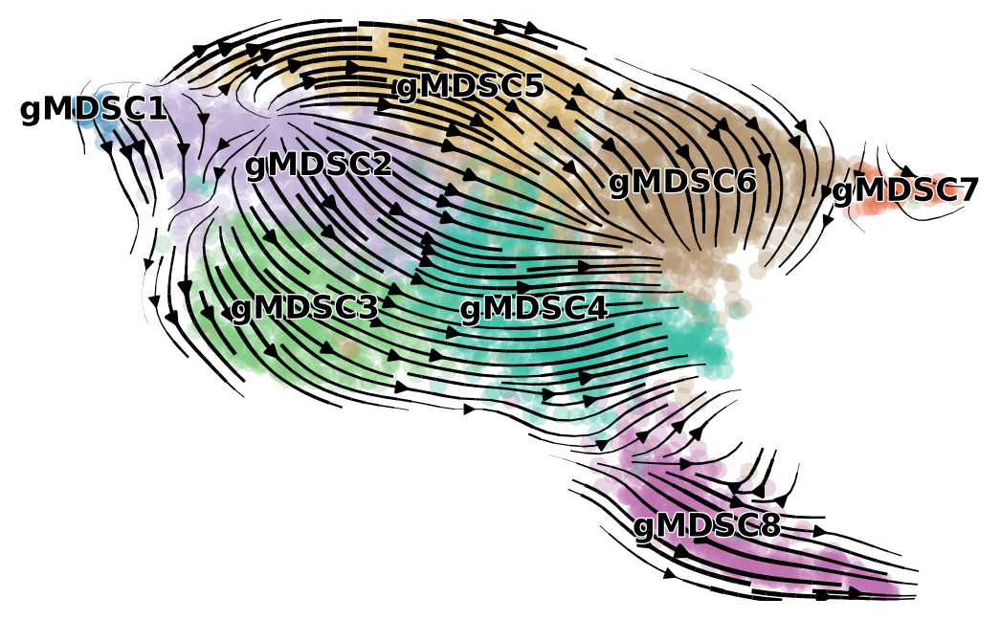

In [62]:
scv.pl.velocity_embedding_stream(adata, basis='umap', title='', smooth=.8, min_mass=2,color='celltype',legend_loc=None,save="umapplot_stream_subNeu_20210508.pdf")#

saving figure to file ./figures/scvelo_heatmap_lineage_heatmap_subNeu_20210508.png


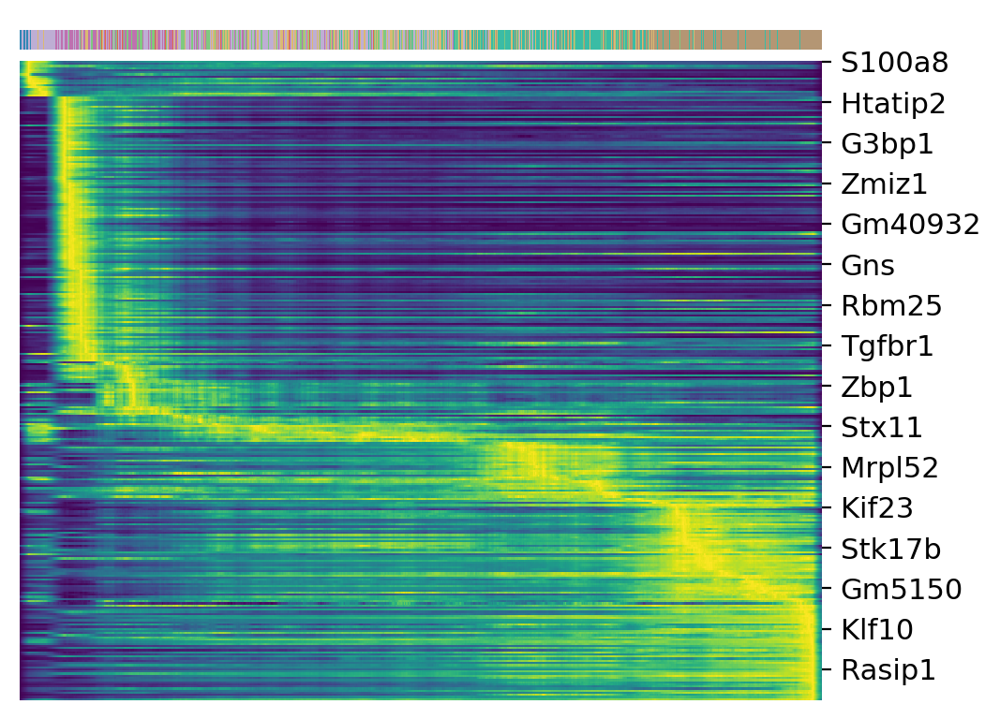

In [63]:
# options(repr.plot.width=6, repr.plot.height=5)
scv.pl.heatmap(adata, var_names=top_genes,sortby='velocity_pseudotime', n_convolve=100, col_color='celltype',figsize=(5.5,4),save="lineage_heatmap_subNeu_20210508.png")

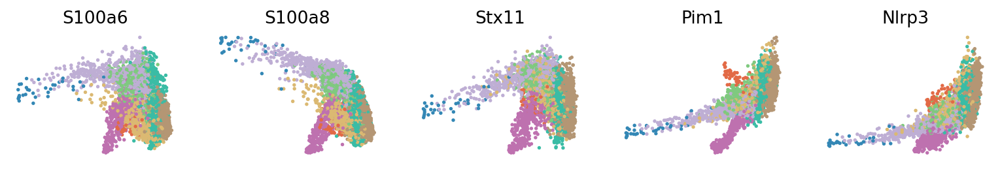

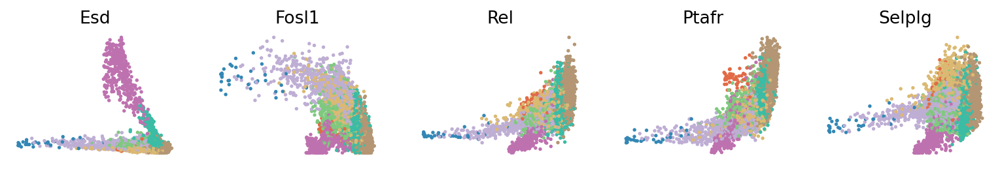

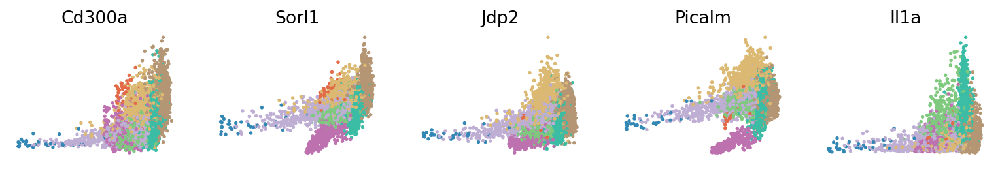

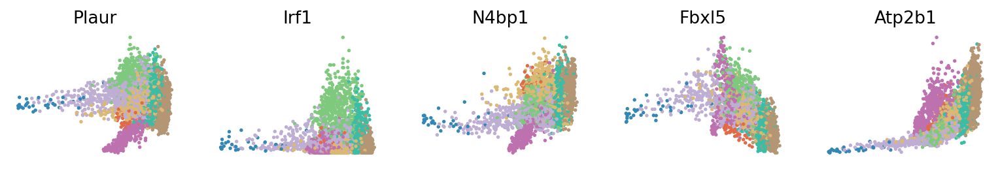

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


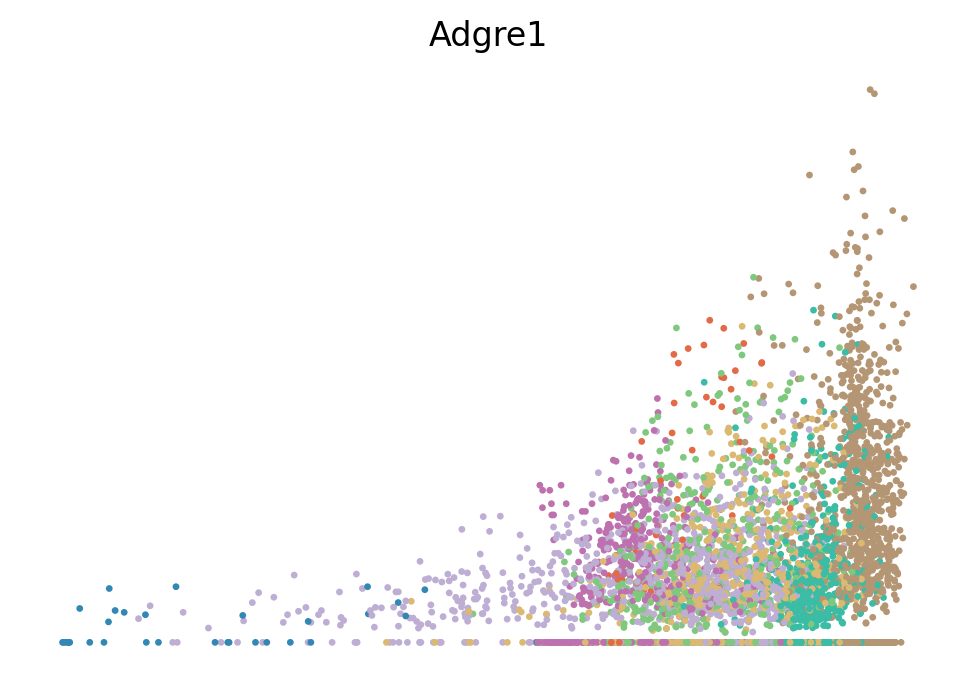

In [64]:
scv.pl.scatter(adata, x='velocity_pseudotime', y=top_genes[:5], frameon=False,color="celltype")
scv.pl.scatter(adata, x='velocity_pseudotime', y=top_genes[5:10], frameon=False,color="celltype")
scv.pl.scatter(adata, x='velocity_pseudotime', y=top_genes[10:15], frameon=False,color="celltype")
scv.pl.scatter(adata, x='velocity_pseudotime', y=top_genes[15:20], frameon=False,color="celltype")

scv.pl.scatter(adata, x='velocity_pseudotime', y=["Adgre1"], frameon=False,color="celltype")

computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


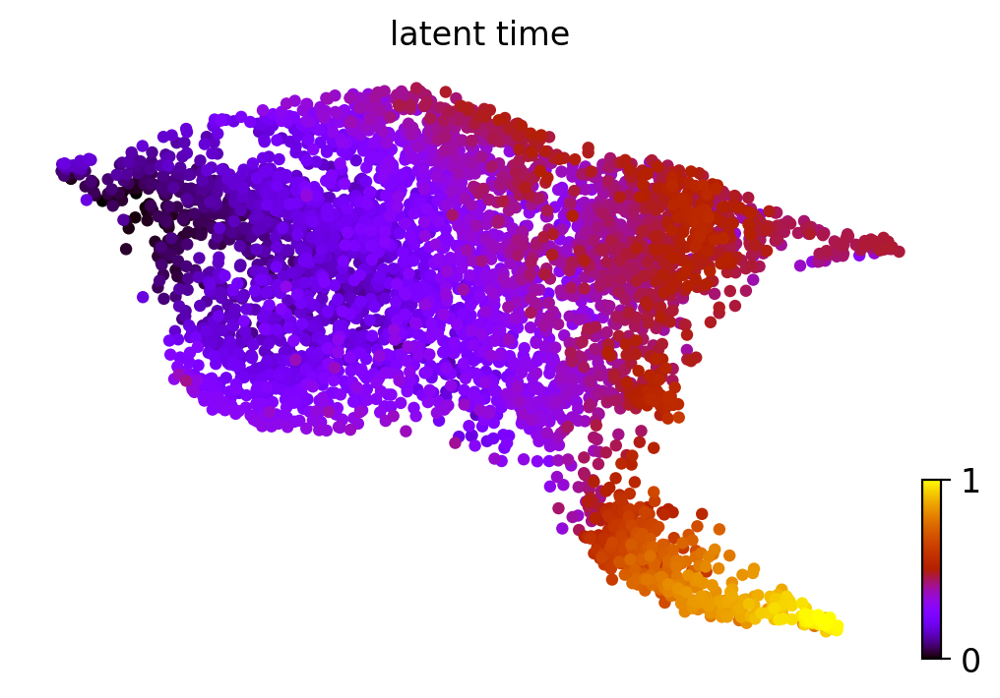

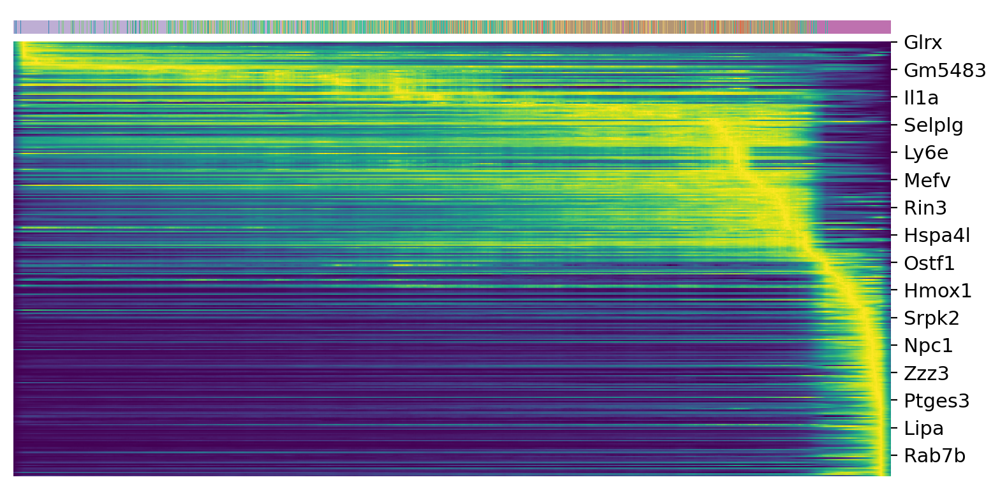

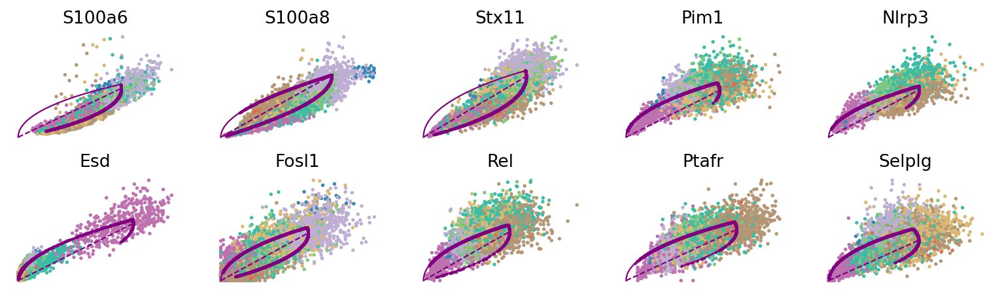

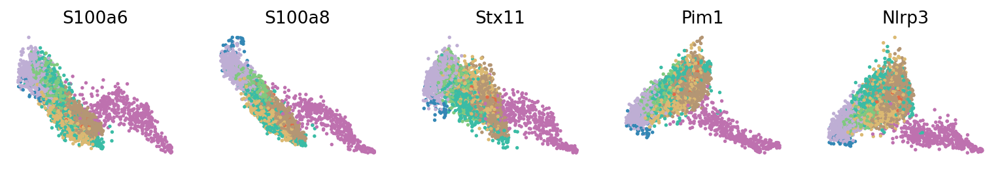

In [65]:
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80, colorbar=True)
top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(adata, var_names=top_genes, tkey='latent_time', n_convolve=100, col_color='celltype')
scv.pl.scatter(adata, basis=top_genes[:10], frameon=False, ncols=5,color='celltype')
# scv.pl.scatter(adata, basis=['Actn4', 'Ppp3ca', 'Cpe', 'Nnat'], frameon=False,color='celltype')
# scv.pl.scatter(adata, x='latent_time', y=['Cd47', 'Id1', 'Mmp8', 'Ifit3'], frameon=False,color='celltype')
scv.pl.scatter(adata, x='latent_time', y=top_genes[:5], frameon=False,color='celltype')

In [47]:
#write scVelo analysis file
adata.write("./write/MDSC_subNeu_scvelo_20210508.h5ad")
#read scVelo analysis file
# adata = scv.read("./write/MDSC_subNeu_scvelo_20210508.h5ad")

## Run CellRank
CellRank offers various ways to infuse directionality into single-cell data. Here, the directional information comes from RNA velocity, and we use this information to compute initial & terminal states as well as fate probabilities for the dynamical process of pancreatic development.

### Identify terminal states

In [115]:
adata_Neu = adata

In [116]:
#read scVelo analysis file
adata = scv.read("./write/MDSC_subNeu_scvelo_20210508.h5ad")

In [66]:
adata.uns["celltype_colors"]=['#975fe3',"#a9a9a9","#ffc1cc","#b2aa0d",'#5298e7','#e32636','#f2991a',"#3abca5"]

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


Setting `softmax_scale=4.6189`


    Finish (0:00:06)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing eigendecomposition of the transition matrix
Adding `adata.uns['eig_fwd']`
       `.eigendecomposition`
    Finish (0:00:00)
Computing Schur decomposition
Adding `adata.uns['eig_fwd']`
       `.eigendecomposition`
       `.schur`
       `.schur_matrix`
    Finish (0:00:36)
Computing `2` macrostates
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:05)
Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
    Finish
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotli

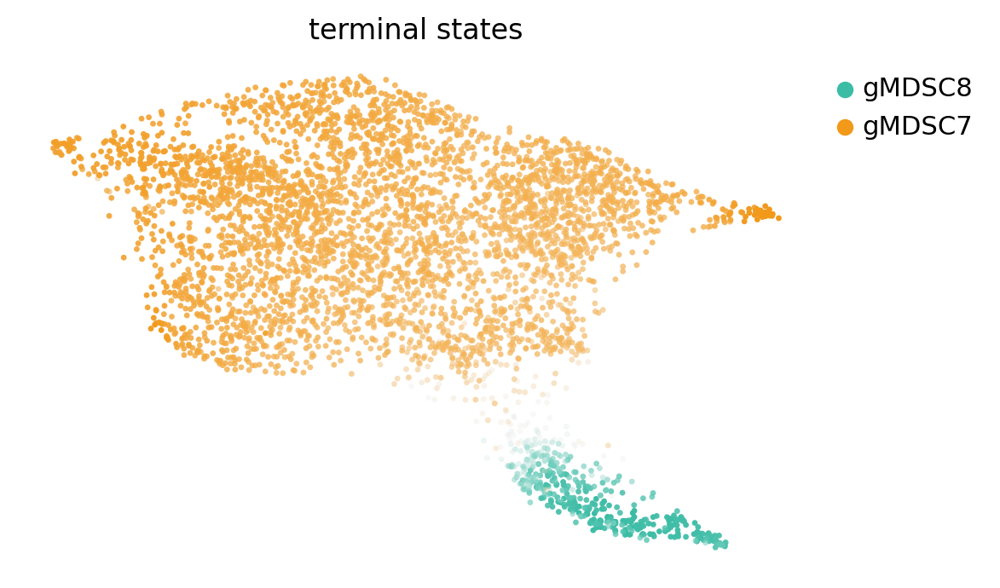

In [67]:
cr.tl.terminal_states(adata, cluster_key='celltype', weight_connectivities=0.2)
cr.pl.terminal_states(adata)

### Identify terminal states

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


Setting `softmax_scale=4.6189`


    Finish (0:00:09)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Computing eigendecomposition of the transition matrix
Adding `adata.uns['eig_bwd']`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `.macrostates_memberships`
        `.macrostates`
    Finish (0:00:00)
Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`
       `adata.obsm['macrostates_bwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
    Finish
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default a

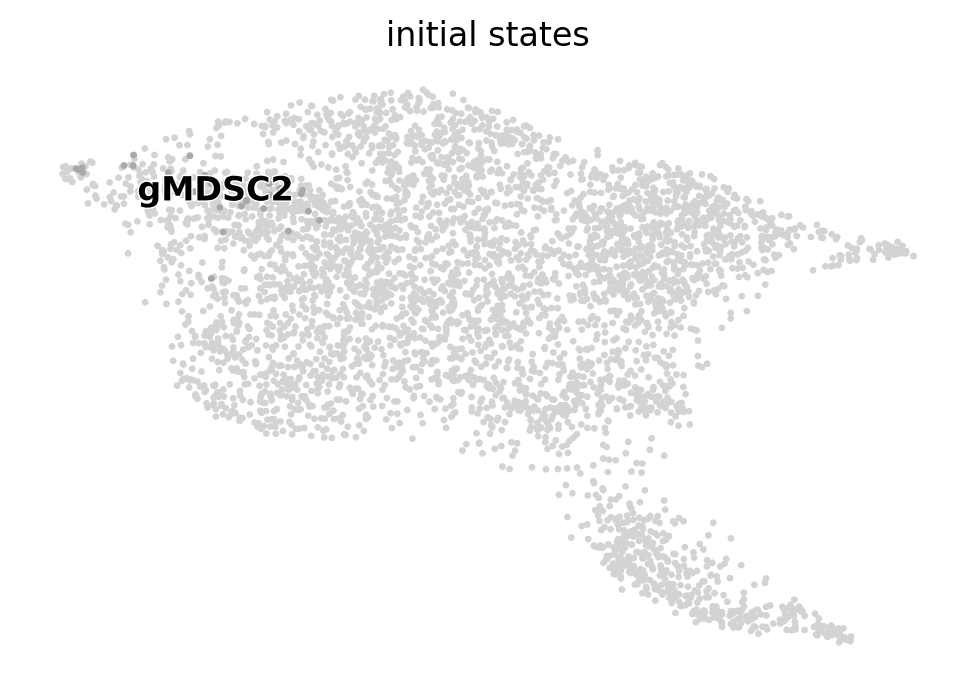

In [68]:
cr.tl.initial_states(adata, cluster_key='celltype')
cr.pl.initial_states(adata, discrete=True)

In [69]:
adata.uns["initial_states_names"]
adata.obs["initial_states"]

0       NaN
2       NaN
4       NaN
7       NaN
8       NaN
       ... 
7816    NaN
7817    NaN
7819    NaN
7820    NaN
7821    NaN
Name: initial_states, Length: 4356, dtype: category
Categories (1, object): ['gMDSC2']

### Compute fate maps

Computing lineage probabilities towards terminal states
Computing absorption probabilities


Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:02)
Adding lineages to `adata.obsm['to_terminal_states']`
    Finish (0:00:02)


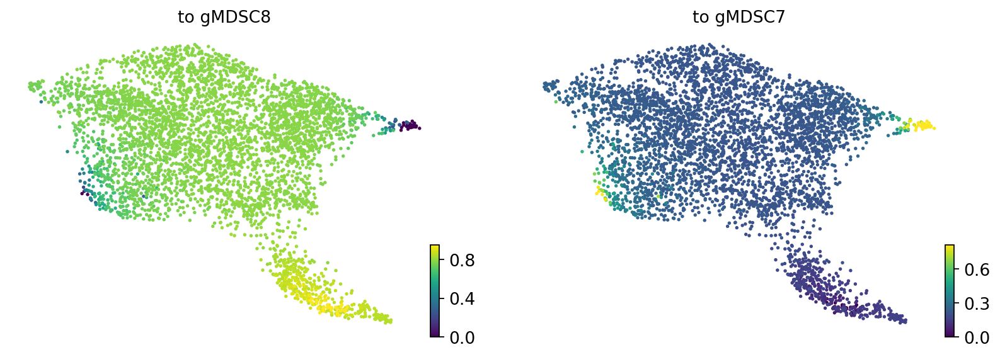

In [70]:
cr.tl.lineages(adata)
cr.pl.lineages(adata, same_plot=False)

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


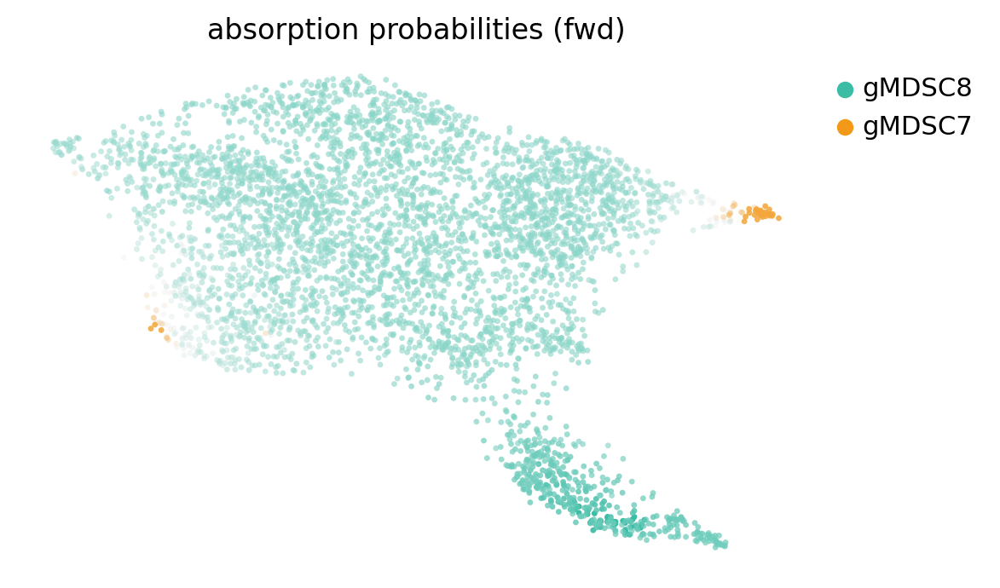

In [71]:
cr.pl.lineages(adata, same_plot=True)

### Directed PAGA

In [72]:
scv.tl.recover_latent_time(adata, root_key='initial_states_probs', end_key='terminal_states_probs')

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)


In [73]:
scv.tl.paga(adata, groups='celltype', root_key='initial_states_probs', end_key='terminal_states_probs',
            use_time_prior='velocity_pseudotime')

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:01) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

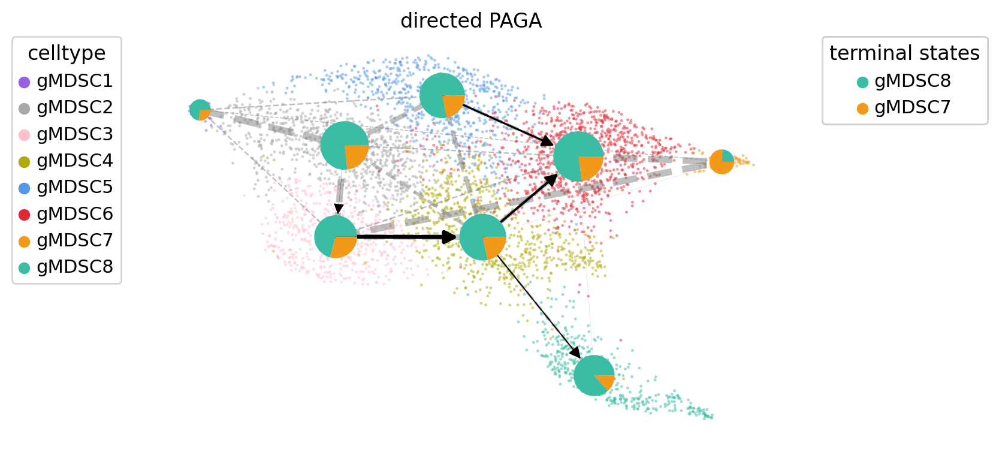

In [74]:
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

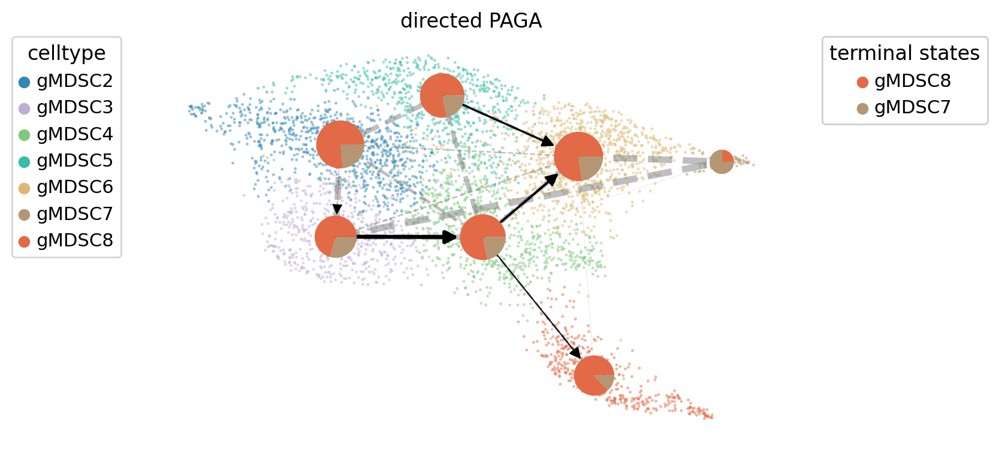

In [24]:
#将gMDSC1和gMDSC2合并后的结果
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(ax.transData))
/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/paga.py:1090: MatplotlibDeprecationWarning: 
The inverse_transformed function was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use transformed(transform.inverted()) instead.
  bboxes.append(result.inverse_transformed(a

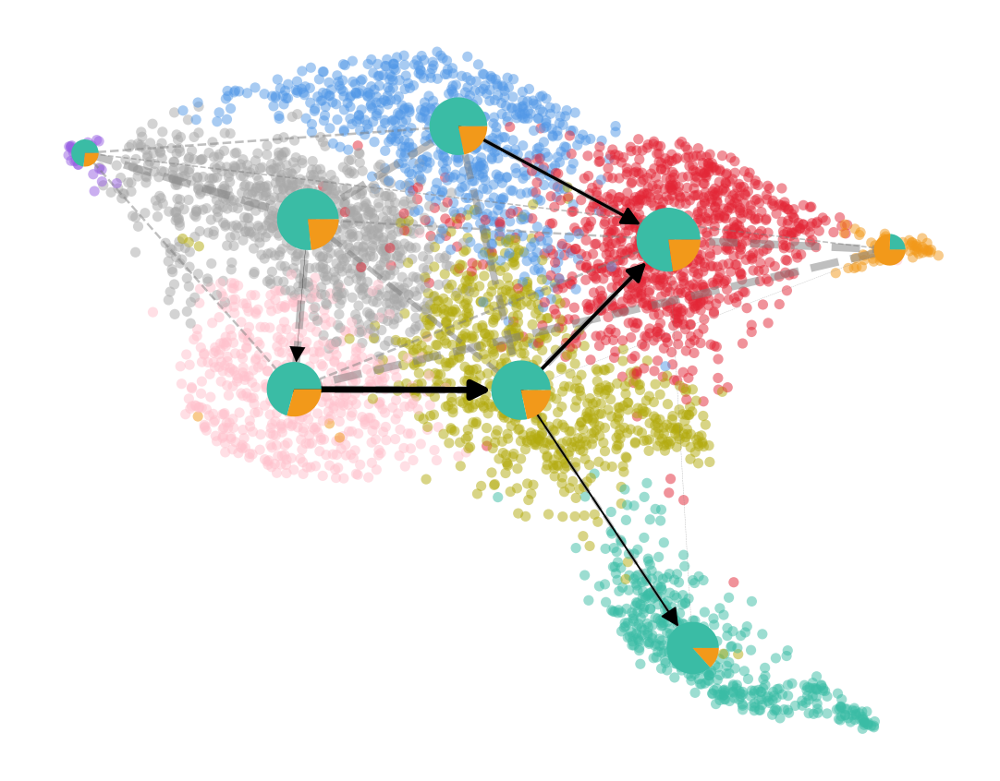

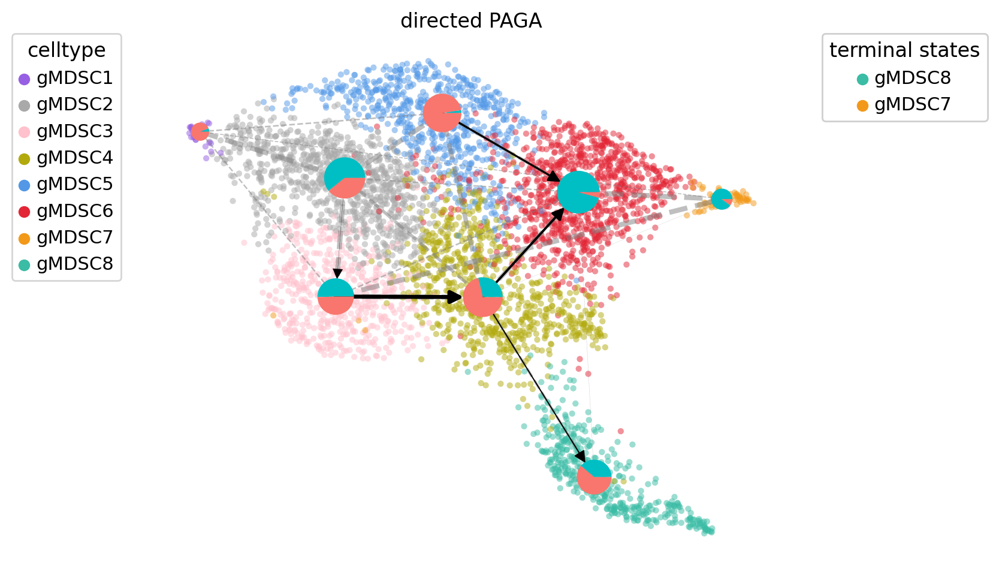

In [75]:
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',
                    legend_kwargs={'loc': 'none'}, legend_loc='none',size=65,
                    node_size_scale=3, edge_width_scale=1, max_edge_width=3, title='',
                    figsize=(6,4.7),save="./write/subNeu_PAGA_celltype.pdf")
adata.uns["group_colors"]=["#00bfc4","#f8766d"]
cr.pl.cluster_fates(adata, mode="paga_pie", cluster_key="celltype", basis='umap',colors=["group"],
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',size=55,
                    node_size_scale=3, edge_width_scale=1, max_edge_width=3, title='directed PAGA',
                    figsize=(6,5),save="./write/subNeu_PAGA_group.pdf")

In [76]:
adata.uns["group_colors"]=["#f8766d","#00bfc4"]

adata.uns["initial_states_colors"]=["#a9a9a9"]
adata.uns["terminal_states_colors"]=["#3abca5",'#f2991a']
adata.uns["celltype_colors"]=['#975fe3',"#a9a9a9","#ffc1cc","#b2aa0d",'#5298e7','#e32636','#f2991a',"#3abca5"]

/home/wangxf/data/tools/python3/lib/python3.8/site-packages/scvelo/plotting/utils.py:115: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = pl.figure(None, figsize, dpi=dpi).gca(projection=projection)


saving figure to file ./figures/scvelo_umapplot_group_subNeu_20210508.pdf


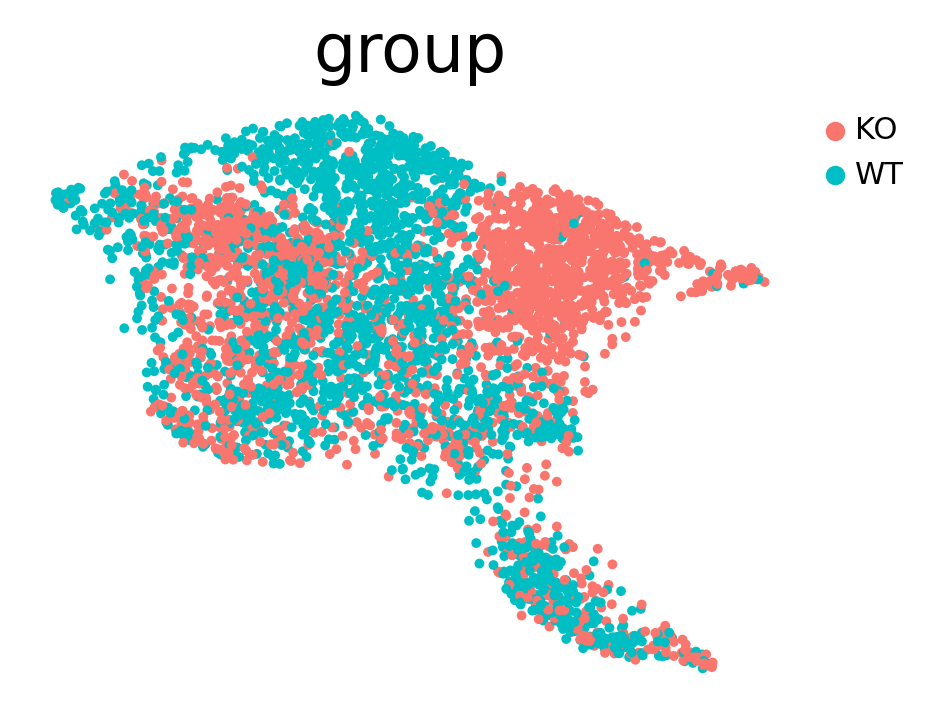

In [78]:
scv.pl.scatter(adata, color='group', fontsize=24, size=50,basis="umap",
               color_map='gnuplot', perc=[2, 98], colorbar=True, rescale_color=[0,1],figsize=(5,4),save="umapplot_group_subNeu_20210508.pdf")

### Compute lineage drivers

In [79]:
cr.tl.lineage_drivers(adata)

Computing correlations for lineages `['gMDSC8' 'gMDSC7']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to gMDSC8 corr']`
       `adata.var['to gMDSC7 corr']`
    Finish (0:00:00)


,gMDSC8 corr,gMDSC8 pval,gMDSC8 qval,gMDSC8 ci low,gMDSC8 ci high,gMDSC7 corr,gMDSC7 pval,gMDSC7 qval,gMDSC7 ci low,gMDSC7 ci high
Ftl1,0.323554,1.225078e-108,2.041797e-106,0.296707,0.349890,-0.323538,1.258174e-108,2.096956e-106,-0.349874,-0.296691
Cstb,0.301637,9.452181e-94,1.134262e-91,0.274397,0.328393,-0.301624,9.634142e-94,1.156097e-91,-0.328381,-0.274384
Ctsb,0.291870,1.533268e-87,1.703631e-85,0.264465,0.318805,-0.291857,1.562285e-87,1.735872e-85,-0.318792,-0.264451
Mif,0.288840,1.149349e-85,1.188981e-83,0.261385,0.315829,-0.288828,1.169301e-85,1.209622e-83,-0.315817,-0.261372
Hmox1,0.275790,7.273960e-78,7.039316e-76,0.248124,0.303006,-0.275777,7.406688e-78,7.167763e-76,-0.302993,-0.248111
...,...,...,...,...,...,...,...,...,...,...
Cmpk2,-0.494920,1.260030e-280,7.560182e-278,-0.517019,-0.472162,0.494924,1.241896e-280,7.451377e-278,0.472167,0.517023
Rsad2,-0.537414,0.000000e+00,0.000000e+00,-0.558203,-0.515950,0.537420,0.000000e+00,0.000000e+00,0.515957,0.558209
Ifit3b,-0.538064,0.000000e+00,0.000000e+00,-0.558832,-0.516621,0.538069,0.000000e+00,0.000000e+00,0.516627,0.558837
Ifit1,-0.671575,0.000000e+00,0.000000e+00,-0.687560,-0.654940,0.671581,0.000000e+00,0.000000e+00,0.654946,0.687566


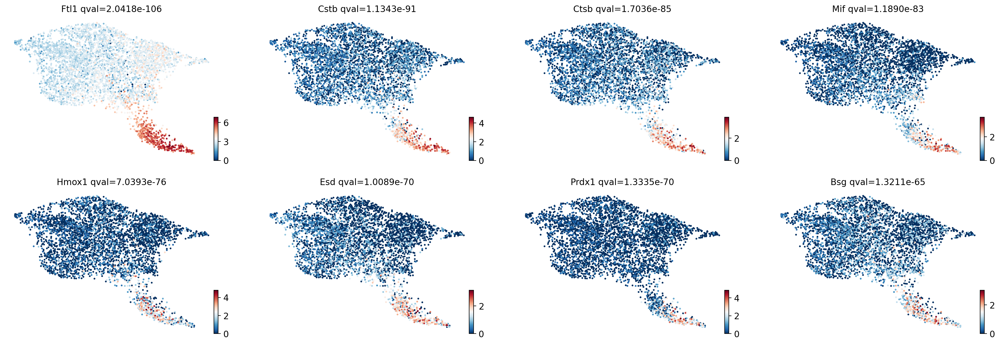

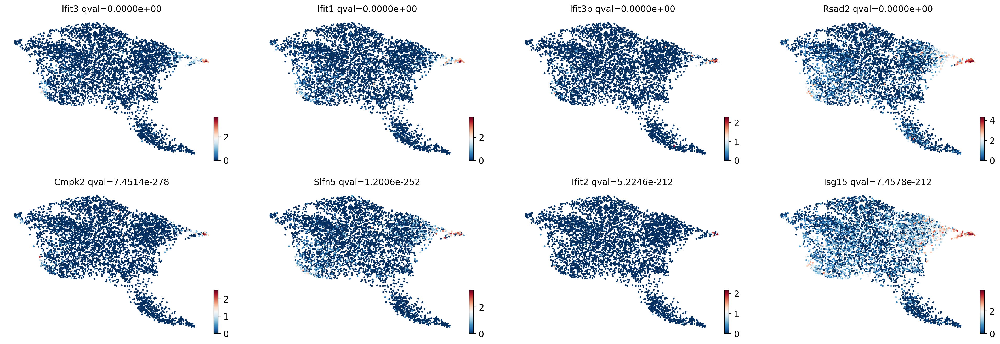

In [80]:
cr.pl.lineage_drivers(adata, lineage="gMDSC8", n_genes=8)
cr.pl.lineage_drivers(adata, lineage="gMDSC7", n_genes=8)

### Gene expression trends

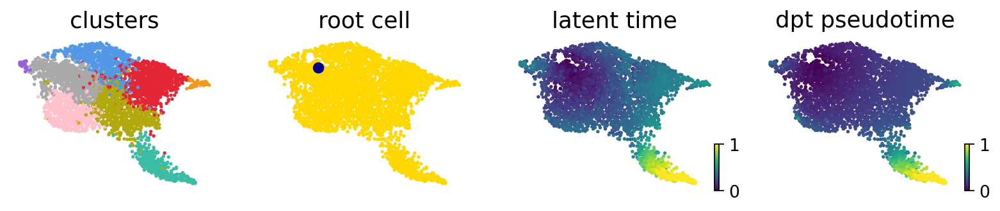

In [81]:
# compue dpt, starting from CellRank defined root cell
root_idx = np.where(adata.obs['initial_states'] == 'gMDSC2')[0][0]
adata.uns['iroot'] = root_idx
sc.tl.dpt(adata)

scv.pl.scatter(adata, color=['celltype', root_idx, 'latent_time', 'dpt_pseudotime'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['clusters', 'root cell', 'latent time', 'dpt pseudotime'])

Computing trends using `1` core(s)


    Finish (0:00:00)
Plotting trends


Computing trends using `1` core(s)


    Finish (0:00:00)


Plotting trends


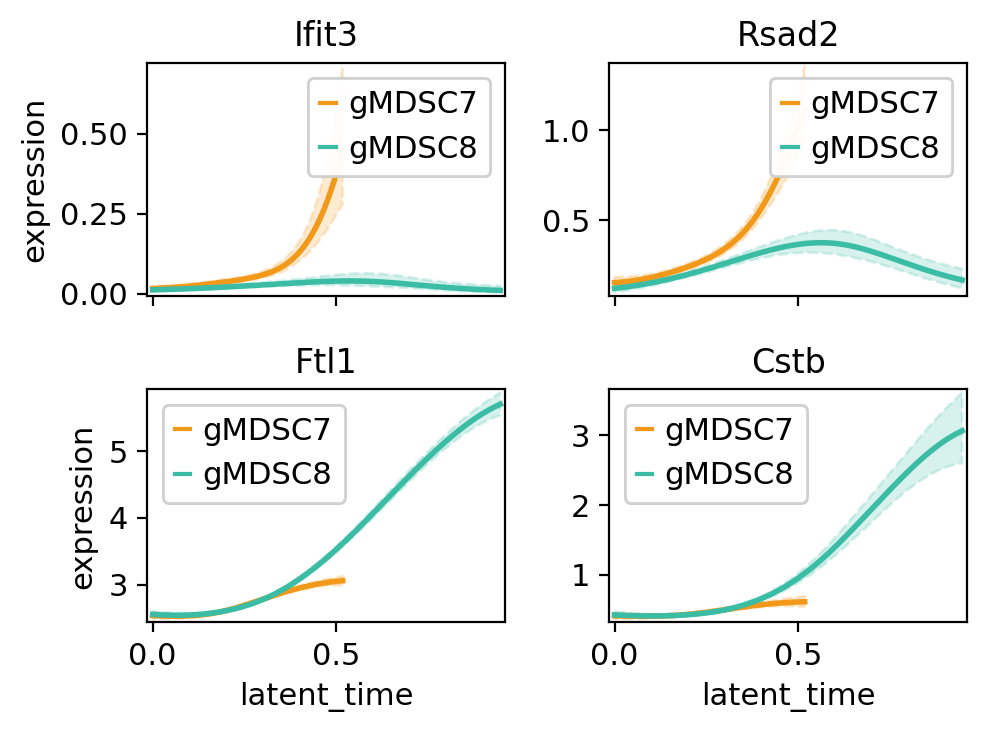

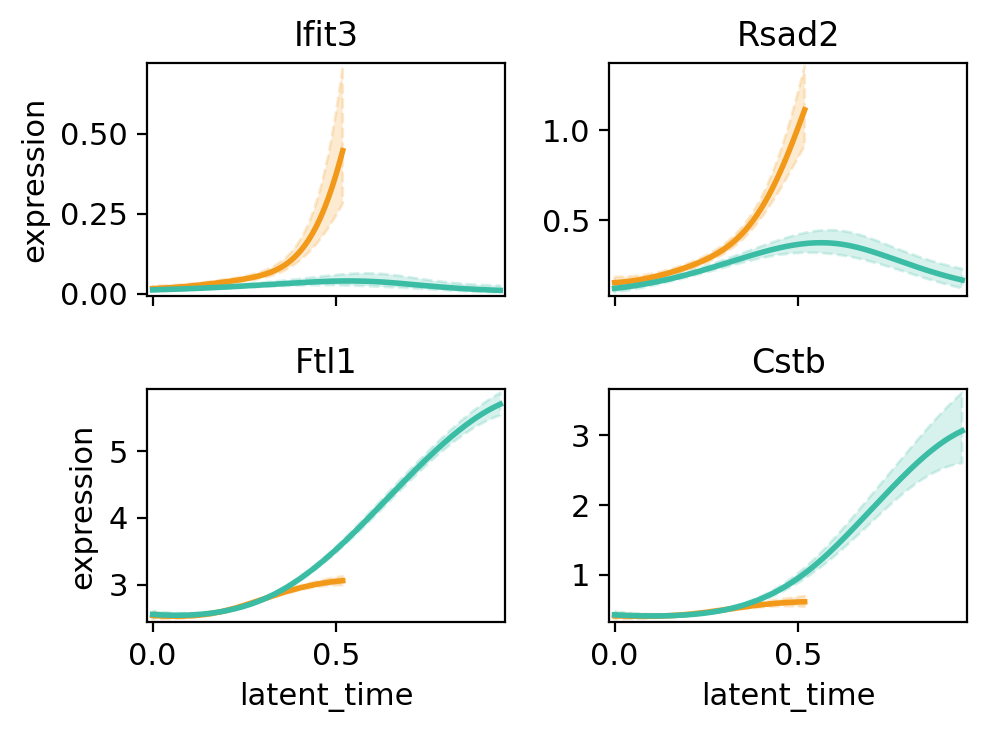

In [82]:
model = cr.ul.models.GAM(adata)
cr.pl.gene_trends(adata, model=model, data_key='X',
                  genes=['Ifit3','Rsad2','Ftl1','Cstb'], ncols=2,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  figsize=(5, 4), n_test_points=200)#,legend_loc=None
cr.pl.gene_trends(adata, model=model, data_key='X',
                  genes=['Ifit3','Rsad2','Ftl1','Cstb'], ncols=2,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  figsize=(5, 4), n_test_points=200,legend_loc=None)#

Computing trends using `1` core(s)


    Finish (0:00:04)


Computing trends using `1` core(s)


    Finish (0:00:04)


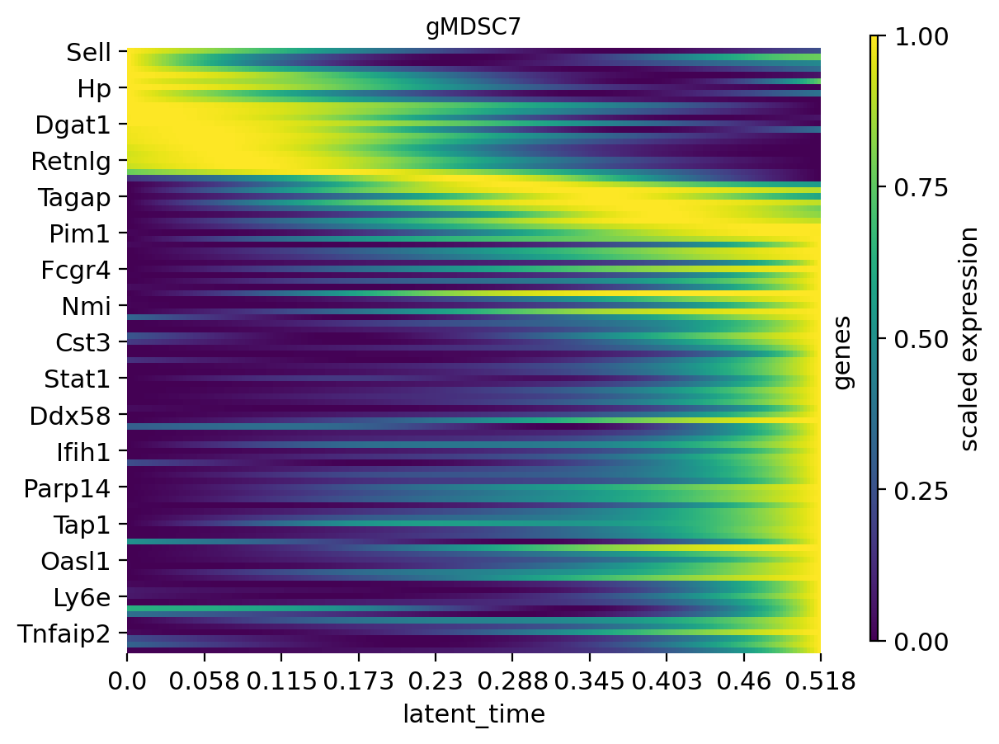

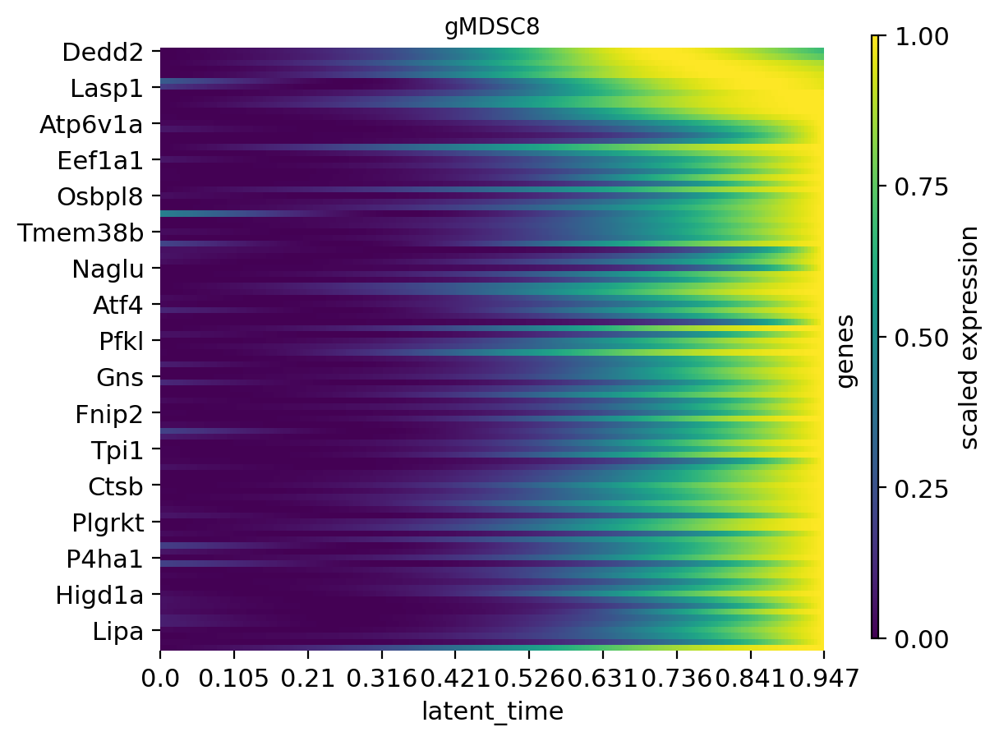

In [83]:
# import matplotlib as mpl
plt.rcParams['font.family'] = 'Arial'
# mpl.rcParams['font.sans-serif']=['SimHei']  #为了正常显示中文
cr.pl.heatmap(adata, model, genes=adata.var['to gMDSC7 corr'].sort_values(ascending=False).index[:100],
              show_absorption_probabilities=False,
              lineages="gMDSC7", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))
cr.pl.heatmap(adata, model, genes=adata.var['to gMDSC8 corr'].sort_values(ascending=False).index[:100],
              show_absorption_probabilities=False,
              lineages="gMDSC8", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5))

In [84]:
# options(repr.plot.width=6, repr.plot.height=5)
adata.var['to gMDSC7 corr'].sort_values(ascending=False).index[:5]

Index(['Ifit3', 'Ifit1', 'Ifit3b', 'Rsad2', 'Cmpk2'], dtype='object')

In [85]:
adata.var['to gMDSC7 corr'].sort_values(ascending=False)

Ifit3     0.688724
Ifit1     0.671581
Ifit3b    0.538069
Rsad2     0.537420
Cmpk2     0.494924
            ...   
Hmox1    -0.275777
Mif      -0.288828
Ctsb     -0.291857
Cstb     -0.301624
Ftl1     -0.323538
Name: to gMDSC7 corr, Length: 3000, dtype: float64

In [48]:
#write scVelo analysis file
adata.write("./write/MDSC_subNeu_scvelo_20210508.h5ad")
#read scVelo analysis file
# adata_Neu = cr.read("./write/MDSC_subNeu_scvelo_20210508.h5ad")
mycol_subMye = ["#7fc67f","#e58f70",  "#ba7fb7","#5b86ab","#eb0875",'#ffe135',#Macrophage
                  '#e76da2',  "#b49674","#d531ae",'#72daf2', #DC
                  '#975fe3',"#a9a9a9","#ffc1cc","#b2aa0d",'#5298e7','#e32636','#f2991a',"#3abca5",#Neutrophil
                 '#dbb972',"#c5aac3","#e26a46"]#Mast cell ##new colors

### write out latent time of cells and lineage drive genes

In [119]:
adata = cr.read("./write/MDSC_subNeu_scvelo_20210508.h5ad")

Creating forward `Lineage` from `adata.obsm['to_terminal_states']`
    Successfully loaded names
    Successfully loaded colors


In [86]:
adata.obs

,Clusters,Lcelltype,Tcelltype,_X,_Y,allLabel,celltype,group,nCount_RNA,nFeature_RNA,...,clusters_gradients,root_cells,end_points,velocity_pseudotime,latent_time,terminal_states,terminal_states_probs,initial_states,initial_states_probs,dpt_pseudotime
0,4,Neutrophil,Neutrophil,-28.611614,-8.926436,mM18_gMDSC_Prdx1,gMDSC8,KO,1016,324,...,gMDSC8,0.003560,0.027963,0.742029,0.856074,NaN,0.821991,NaN,0.000036,0.601307
2,2,Neutrophil,Neutrophil,22.081251,21.456640,mM14_gMDSC_Clec5a,gMDSC4,WT,986,481,...,gMDSC8,0.004030,0.419582,0.109711,0.260724,NaN,0.864287,NaN,0.000381,0.151265
4,3,Neutrophil,Neutrophil,-7.907442,49.644989,mM14_gMDSC_Clec5a,gMDSC4,KO,4366,1042,...,gMDSC8,0.001963,0.026933,0.122406,0.205480,NaN,0.875286,NaN,0.000999,0.139402
7,1,Neutrophil,Neutrophil,14.634216,-25.281103,mM18_gMDSC_Prdx1,gMDSC8,WT,1507,461,...,gMDSC8,0.003334,0.016223,0.771955,0.841391,NaN,0.929867,NaN,0.000030,0.654458
8,5,Neutrophil,Neutrophil,-7.741055,24.950951,mM12_gMDSC_Mmp8,gMDSC2,WT,3694,1006,...,gMDSC8,0.140540,0.000911,0.062774,0.052855,NaN,0.903778,NaN,0.115569,0.065621
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7816,6,Neutrophil,Neutrophil,-7.143039,40.060303,mM18_gMDSC_Prdx1,gMDSC8,WT,3024,720,...,gMDSC8,0.005058,0.016177,0.674461,0.758177,NaN,0.874030,NaN,0.000239,0.536441
7817,9,Neutrophil,Neutrophil,-5.622938,31.742191,mM16_gMDSC_H2-Q10,gMDSC6,KO,2214,833,...,gMDSC8,0.001065,0.043971,0.132588,0.356374,NaN,0.879983,NaN,0.000070,0.177680
7819,3,Neutrophil,Neutrophil,8.278304,21.180367,mM18_gMDSC_Prdx1,gMDSC8,KO,7060,1172,...,gMDSC8,0.003258,0.148435,0.490134,0.665101,NaN,0.587866,NaN,0.000121,0.429470
7820,2,Neutrophil,Neutrophil,15.028574,7.519513,mM12_gMDSC_Mmp8,gMDSC2,KO,6566,1337,...,gMDSC8,0.023230,0.002445,0.069589,0.038391,NaN,0.904306,NaN,0.018345,0.056731


In [87]:
adata.obs[['obs_names','latent_time']]

,obs_names,latent_time
0,H389WT_out:TCCGATCGTCGTACTAx,0.856074
2,H124KO_out:CATTTCATCTAAACGCx,0.260724
4,H389WT_out:ATGGGTTCATGAAAGTx,0.205480
7,H124KO_out:CAACGATCATGTTCGAx,0.841391
8,H124KO_out:TCTCAGCTCTTGTTACx,0.052855
...,...,...
7816,H124KO_out:CATACAGCAACTGGTTx,0.758177
7817,H382jia390KO_out:TCGAAGTCAGCTGTTAx,0.356374
7819,H389WT_out:TTCGGTCCATGGATCTx,0.665101
7820,H389WT_out:CCTACGTAGGAGATAGx,0.038391


In [88]:
pseu_Neu=adata_Neu.obs[['obs_names','latent_time']]
pseu_Neu.to_csv("./write/MDSC_subNeu_scvelo_pseudotime_20210508.csv")

In [35]:
adata_Neu.var[['to gMDSC8 corr', 'to gMDSC7 corr', 'to gMDSC8 qval', 'to gMDSC7 qval']]

,to gMDSC8 corr,to gMDSC7 corr,to gMDSC8 qval,to gMDSC7 qval
Vcpip1,-0.078599,0.078600,1.304825e-06,1.304438e-06
Arfgef1,0.025868,-0.025868,1.647411e-01,1.647472e-01
Ncoa2,-0.021462,0.021461,2.614709e-01,2.614914e-01
Lactb2,0.028329,-0.028326,1.226838e-01,1.227261e-01
Ogfrl1,-0.092257,0.092255,8.606913e-09,8.614938e-09
...,...,...,...,...
Huwe1,0.009548,-0.009548,6.554368e-01,6.554147e-01
Smc1a,0.000395,-0.000396,9.831513e-01,9.830775e-01
Kdm5c,0.026950,-0.026949,1.445642e-01,1.445844e-01
Bclaf3,0.007341,-0.007341,7.306966e-01,7.306701e-01


In [89]:
lineage_driveGene = adata_Neu.var[['to gMDSC8 corr', 'to gMDSC7 corr', 'to gMDSC8 qval', 'to gMDSC7 qval']]
lineage_driveGene.to_csv("./write/MDSC_subNeu_scvelo_lineage_driveGene_20210508.csv")

Computing trends using `1` core(s)


         to gMDSC8 corr  to gMDSC7 corr  to gMDSC8 qval  to gMDSC7 qval
Vcpip1        -0.078599        0.078600    1.304825e-06    1.304438e-06
Arfgef1        0.025868       -0.025868    1.647411e-01    1.647472e-01
Ncoa2         -0.021462        0.021461    2.614709e-01    2.614914e-01
Lactb2         0.028329       -0.028326    1.226838e-01    1.227261e-01
Ogfrl1        -0.092257        0.092255    8.606913e-09    8.614938e-09
...                 ...             ...             ...             ...
Huwe1          0.009548       -0.009548    6.554368e-01    6.554147e-01
Smc1a          0.000395       -0.000396    9.831513e-01    9.830775e-01
Kdm5c          0.026950       -0.026949    1.445642e-01    1.445844e-01
Bclaf3         0.007341       -0.007341    7.306966e-01    7.306701e-01
Gm47283        0.030480       -0.030481    9.390079e-02    9.389456e-02

[3000 rows x 4 columns]
317
112


    Finish (0:00:05)


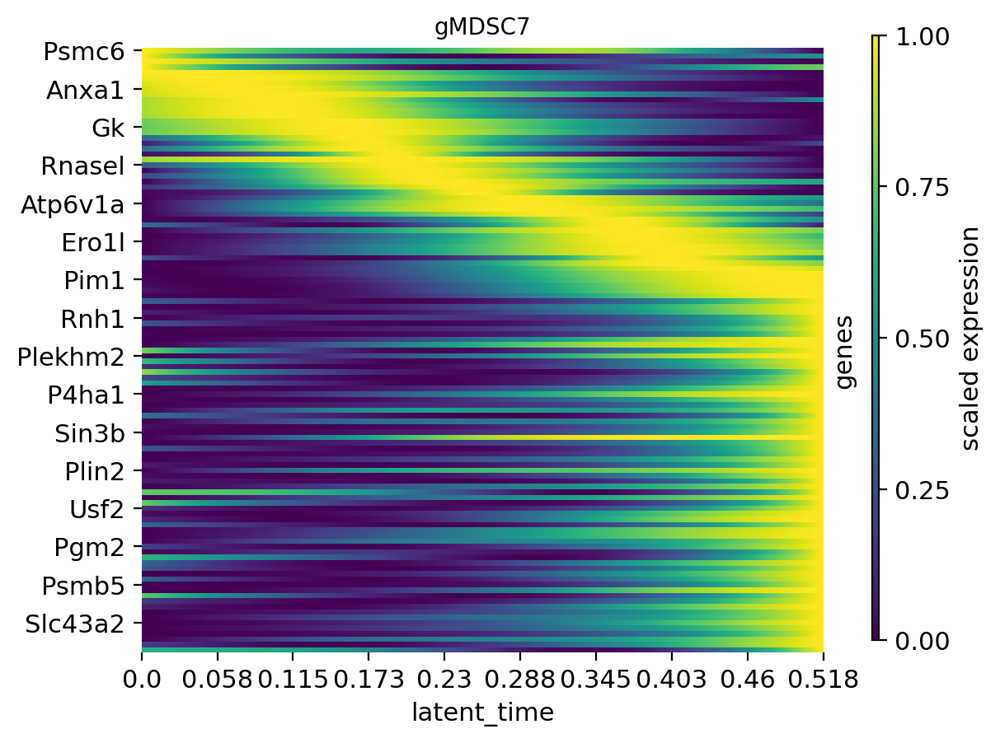

In [125]:
###画lineage相关基因的heatmap
lineage_driveGenes = adata.var[['to gMDSC8 corr', 'to gMDSC7 corr', 'to gMDSC8 qval', 'to gMDSC7 qval']]
print(lineage_driveGenes)

sublineage_driveGenes = lineage_driveGenes.loc[abs(lineage_driveGenes["to gMDSC7 corr"]) > 0.1, ]
Genes  = sublineage_driveGenes.sort_values(["to gMDSC7 corr"],ascending=False).index[:]
print(len(Genes))

top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
#取交集
fitGenes = set(Genes).intersection(set(top_genes))
print(len(fitGenes))
#写出heatmap所用的基因
with open("./write/fitGenes112_heatmap_lineagegMDSC7.txt","w") as f:
    f.write(str(fitGenes))
    
model = cr.ul.models.GAM(adata)
cr.pl.heatmap(adata, model, genes=fitGenes, #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="gMDSC7", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5),save="./write/fitGenes112_heatmap_lineagegMDSC7.pdf")

Computing trends using `1` core(s)


         to gMDSC8 corr  to gMDSC7 corr  to gMDSC8 qval  to gMDSC7 qval
Vcpip1        -0.078599        0.078600    1.304825e-06    1.304438e-06
Arfgef1        0.025868       -0.025868    1.647411e-01    1.647472e-01
Ncoa2         -0.021462        0.021461    2.614709e-01    2.614914e-01
Lactb2         0.028329       -0.028326    1.226838e-01    1.227261e-01
Ogfrl1        -0.092257        0.092255    8.606913e-09    8.614938e-09
...                 ...             ...             ...             ...
Huwe1          0.009548       -0.009548    6.554368e-01    6.554147e-01
Smc1a          0.000395       -0.000396    9.831513e-01    9.830775e-01
Kdm5c          0.026950       -0.026949    1.445642e-01    1.445844e-01
Bclaf3         0.007341       -0.007341    7.306966e-01    7.306701e-01
Gm47283        0.030480       -0.030481    9.390079e-02    9.389456e-02

[3000 rows x 4 columns]
317
112


did not converge


    Finish (0:00:11)


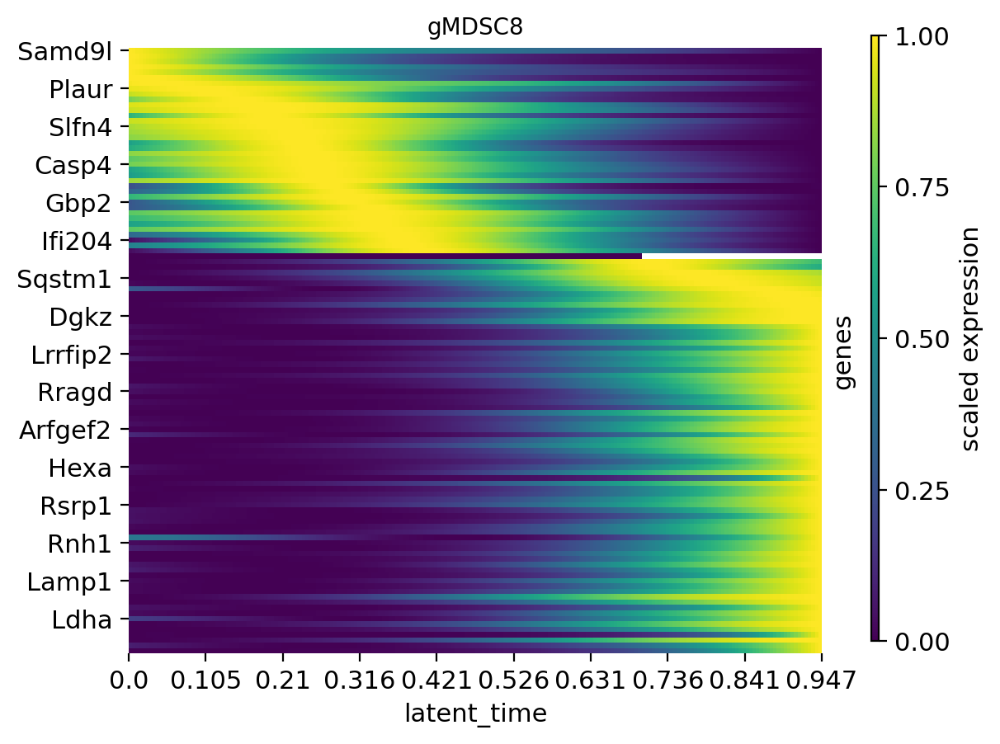

In [131]:
###画lineage相关基因的heatmap
lineage_driveGenes = adata.var[['to gMDSC8 corr', 'to gMDSC7 corr', 'to gMDSC8 qval', 'to gMDSC7 qval']]
print(lineage_driveGenes)

sublineage_driveGenes = lineage_driveGenes.loc[abs(lineage_driveGenes["to gMDSC8 corr"]) > 0.1, ]
Genes  = sublineage_driveGenes.sort_values(["to gMDSC8 corr"],ascending=False).index[:]
print(len(Genes))

top_genes = adata.var['fit_likelihood'].sort_values(ascending=False).index[:300]
#取交集
fitGenes = set(Genes).intersection(set(top_genes))
print(len(fitGenes))
#写出heatmap所用的基因
with open("./write/fitGenes112_heatmap_lineagegMDSC8.txt","w") as f:
    f.write(str(fitGenes))
    
model = cr.ul.models.GAM(adata)
cr.pl.heatmap(adata, model, genes=fitGenes, #adata_Mac.var['to TAM3 corr'].sort_values(ascending=False).index[:10],
              show_absorption_probabilities=False,
#               cluster_genes=True,
#               show_all_genes=True,
              lineages="gMDSC8", n_jobs=1, backend='loky',
              fontsize=10,figsize=(6.5,5),save="./write/fitGenes112_heatmap_lineagegMDSC8.pdf")

In [133]:
lineage_driveGenes.sort_values(["to gMDSC7 corr"],ascending=False)

,to gMDSC8 corr,to gMDSC7 corr,to gMDSC8 qval,to gMDSC7 qval
Ifit3,-0.688717,0.688724,0.000000e+00,0.000000e+00
Ifit1,-0.671575,0.671581,0.000000e+00,0.000000e+00
Ifit3b,-0.538064,0.538069,0.000000e+00,0.000000e+00
Rsad2,-0.537414,0.537420,0.000000e+00,0.000000e+00
Cmpk2,-0.494920,0.494924,7.560182e-278,7.451377e-278
...,...,...,...,...
Hmox1,0.275790,-0.275777,7.039316e-76,7.167763e-76
Mif,0.288840,-0.288828,1.188981e-83,1.209622e-83
Ctsb,0.291870,-0.291857,1.703631e-85,1.735872e-85
Cstb,0.301637,-0.301624,1.134262e-91,1.156097e-91


In [134]:
lineage_driveGenes.sort_values(["to gMDSC8 corr"],ascending=False)

,to gMDSC8 corr,to gMDSC7 corr,to gMDSC8 qval,to gMDSC7 qval
Ftl1,0.323554,-0.323538,2.041797e-106,2.096956e-106
Cstb,0.301637,-0.301624,1.134262e-91,1.156097e-91
Ctsb,0.291870,-0.291857,1.703631e-85,1.735872e-85
Mif,0.288840,-0.288828,1.188981e-83,1.209622e-83
Hmox1,0.275790,-0.275777,7.039316e-76,7.167763e-76
...,...,...,...,...
Cmpk2,-0.494920,0.494924,7.560182e-278,7.451377e-278
Rsad2,-0.537414,0.537420,0.000000e+00,0.000000e+00
Ifit3b,-0.538064,0.538069,0.000000e+00,0.000000e+00
Ifit1,-0.671575,0.671581,0.000000e+00,0.000000e+00
